In [1]:
# utils
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import re
from math import ceil
from datetime import datetime

def generate_filename_with_timestamp(prefix: str, extension: str, steps=None) -> str:
    current_time = datetime.now()
    time_str = current_time.strftime('%Y-%m-%d_%H-%M-%S')
    if steps is not None:
        time_str = steps
    filename = f"{prefix}_{time_str}.{extension}"
    return filename

# (gen,png, 1) 인경우 gen_01.png 리턴, gen, pnt, 11인 경우 gen_11.png
def generate_filename_with_sequence(prefix: str, extension: str, steps=None) -> str:
    pattern=r'^[0-9]$'
    filename = '0'+str(steps) if re.match(pattern, str(steps)) else str(steps)
    filename = f"{prefix}_{steps}.{extension}"
    return filename


def plot_grid_single(grid, name='temp.png'):
    plt.figure()
    colors = mpl.colormaps['Accent']
    plt.matshow(grid, cmap=colors)
    plt.axis('off')
    plt.savefig(name)
    plt.show()
    
def plot_grids(grids, m, n, k, rows=None, cols=5, fitness_scores=None, savefilename=None):
    """
    Creates a plot with multiple subplots arranged in specified rows and columns, each displaying a grid.

    Parameters:
    - m (int): The number of rows in each grid.
    - n (int): The number of columns in each grid.
    - k (int): The number of color groups in each grid.
    - rows (int): The number of subplot rows.
    - cols (int): The number of subplot columns.
    """
    if rows is None:
        cols = int(cols)
        rows = int(ceil(len(grids) / cols))
    if cols is None:
        rows = int(rows)
        cols = int(ceil(len(grids)/ rows))
    rows, cols = int(rows), int(cols)
    fig, axes = plt.subplots(rows, cols, figsize=(n * cols, m * rows))
    xy_coords = [(x, y) for x in range(rows) for y in range(cols)]
    for ij, grid in enumerate(grids):
        colors = mpl.colormaps['Accent']
        ax = axes[xy_coords[ij]]
        ax.matshow(grid, cmap=colors)
        print(grid)
        if fitness_scores is not None:
            ax.set_title(f'{fitness_scores[ij]:.2f}', fontsize=10)
        ax.axis('off')

    if savefilename is not None:
        plt.savefig(savefilename)
    plt.show()
    
    


In [2]:
# initial Population

def has_neighbor_zero(grid, row, col):
    nrows, ncols = len(grid), len(grid[0])
    # Define relative positions of neighbors (up, down, left, right)
    neighbors = [(-1, 0), (1, 0), (0, -1), (0, 1)]
    for dy, dx in neighbors:
        new_row, new_col = row + dy, col + dx
        if 0 <= new_row < nrows and 0 <= new_col < ncols and grid[new_row][new_col] == 0:
            return True
    return False

def assgin_zero_neighbour_value(grid, cell):
    nrows, ncols = grid.shape  # 그리드의 행과 열 크기
    row, col = cell
    # 이웃의 상대적 위치: 위, 아래, 왼쪽, 오른쪽
    adjacent_offsets = [(-1, 0), (1, 0), (0, -1), (0, 1)]

    better_nonzero_offsets = [
        offset for i, offset in enumerate(adjacent_offsets)
        if 0 <= row + offset[0] < nrows and 0 <= col + offset[1] < ncols and grid[row + offset[0], col + offset[1]] == 0
    ]
    if not better_nonzero_offsets:
        return False
    selected_neighbour_offset = random.choice(better_nonzero_offsets)
    selected_neighbour_loc = (row + selected_neighbour_offset[0], col + selected_neighbour_offset[1])
    grid[selected_neighbour_loc] = grid[row, col]


In [ ]:
# Augmentation

import random
import copy
def count_different_color_neighbors(grid):
    # 그리드의 행과 열의 크기를 가져옵니다.
    rows, cols = len(grid), len(grid[0])
    
    # 상, 하, 좌, 우 방향 정의
    directions = [(-1, 0), (1, 0), (0, -1), (0, 1)]
    
    # 결과를 저장할 리스트를 초기화합니다.
    different_neighbor_count = [[0 for _ in range(cols)] for _ in range(rows)]
    
    # 그리드의 각 셀을 순회합니다.
    for row in range(rows):
        for col in range(cols):
            # 현재 셀의 색깔을 가져옵니다.
            current_color = grid[row][col]
            # 다른 색의 이웃을 세기 위한 카운터
            count = 0
            for d in directions:
                # 이웃 셀의 위치를 계산합니다.
                nr, nc = row + d[0], col + d[1]
                # 이웃 셀이 그리드 범위 내에 있고, 현재 셀과 색깔이 다른지 확인합니다.
                if 0 <= nr < rows and 0 <= nc < cols and grid[nr][nc] != current_color:
                    count += 1
            # 계산된 다른 색의 이웃의 수를 결과 리스트에 저장합니다.
            different_neighbor_count[row][col] = count
    
    return different_neighbor_count


def mutate_find_and_change_color(grid):
    # 자기 자신과 색깔이 다른 이웃의 개수를 계산합니다.
    different_neighbor_counts = count_different_color_neighbors(grid)
    print(f'sum of diff={sum(sum(row) for row in different_neighbor_counts)}')
    rows, cols = len(grid), len(grid[0])
    # 상, 하, 좌, 우 방향 정의
    directions = [(-1, 0), (1, 0), (0, -1), (0, 1)]
    new_grid = copy.deepcopy(grid)

    # 3, 2, 1 순으로 조건에 맞는 셀 찾기
    for target_count in [3, 2, 1]:
        for row in range(rows):
            for col in range(cols):
                if different_neighbor_counts[row][col] == target_count:
                    current_color = new_grid[row][col]
                    # 조건에 맞는 셀의 이웃 중 색깔이 다른 이웃을 찾습니다.
                    different_color_neighbors = []
                    for d in directions:
                        nr, nc = row + d[0], col + d[1]
                        if 0 <= nr < rows and 0 <= nc < cols and new_grid[nr][nc] != current_color:
                            different_color_neighbors.append((nr, nc))
                    # 이웃 중 하나를 임의로 선택하여 색깔 변경
                    if different_color_neighbors:
                        nr, nc = random.choice(different_color_neighbors)
                        # 선택된 이웃의 색깔을 현재 셀의 색깔로 변경
                        new_grid[nr][nc] = current_color
                        return new_grid  # 변경 후 그리드 반환

    return new_grid  # 조건에 맞는 셀이 없는 경우 원본 그리드 반환

def calculate_simplicity_score(matrix):
    # 각 값의 개수를 저장할 딕셔너리
    counts = {0: 0, 1: 0, 2: 0, 3:0, 4:0}
    
    # 매트리스의 각 셀 값을 순회하며 개수를 센다
    for row in matrix:
        for cell in row:
            if cell in counts:
                counts[cell] += 1
    
    # 수정된 가중치 설정
    weights = {0: 100, 1:50, 2: 25, 3:12, 4:0}
    
    # 총 가치 계산
    total_value = sum(counts[value] * weights[value] for value in counts)
    simplicity_fitness = total_value// (len(matrix) *len(matrix[1]))
    return simplicity_fitness


def create_plan(m, n, k):
    grid = np.zeros((m, n), dtype=int)

    # Initialize the grid with k different colors randomly
    for i in range(k):
        cell = (random.randint(0, m - 1), random.randint(0, n - 1))
        while grid[cell] != 0:
            cell = (random.randint(0, m - 1), random.randint(0, n - 1))
        grid[cell] = i + 1

    # Create a list of offsets to look for adjacent cells
    adjacent_offsets = [(-1, 0), (1, 0), (0, -1), (0, 1)]

    # Randomly choose cells to color until all cells are filled
    steps = 0
    while np.any(grid == 0):
        subset_cells_nonzero = [(row, col) for row in range(len(grid)) for col in range(len(grid[0])) if
                                has_neighbor_zero(grid, row, col) and grid[row, col] != 0]
        cell = tuple(subset_cells_nonzero[random.randint(0, len(subset_cells_nonzero) - 1)])

        # colored cell 중에서 neibhbour가 0인 with_zero_neibhbour_cell
        random.shuffle(adjacent_offsets)  # 여기서 Shuffle을 하지 말고, possible shuffle을 해야 한다.
        assgin_zero_neighbour_value(grid, cell)

        steps += 1

        # Save Initialization Steps one by one into one large file
        # plot_grid_k_distinct_color(grid, k + 1, steps)

    return grid

   
    
def module_main():
    m, n, k, num_pops, cols = 3, 5, 4, 10, 5
    rows = ceil(num_pops / cols)
    
    grids = []
    simplicity_scores=[]
    for pop in range(num_pops):
        grid = create_plan(m, n, k)
        grids.append(grid)
        
        
    count_grid = count_different_color_neighbors(grid)
    fit = calculate_simplicity_score(count_grid)
    
    print(f'counts = {count_grid}')
    print(f'fit = {fit}')
    print('new_grid\n')
    for grid in grids:
        child = mutate_find_and_change_color(grid)
        num_diff_neibhbors = count_different_color_neighbors(child)
        print(f'count_grid = {num_diff_neibhbors}')
        new_fit = calculate_simplicity_score(count_grid)
        print(f'fit = {new_fit}')
        simplicity_scores.append(new_fit)
        print('\n')
        grids.append(child)
        
    print(f'len(child)={len(child)}')
    plotfilename=generate_filename_with_sequence('plot', 'png', 1)

    plot_grids(grids, m, n, k, rows, cols, simplicity_scores, plotfilename)

module_main()    



counts = [[2, 1, 1, 2, 1], [2, 2, 2, 2, 1], [0, 1, 1, 0, 0]]
fit = 50
new_grid

sum of diff=14
count_grid = [[0, 0, 2, 2, 1], [0, 1, 3, 2, 2], [0, 0, 2, 2, 1]]
fit = 50


sum of diff=22
count_grid = [[1, 1, 2, 2, 1], [2, 3, 3, 2, 1], [1, 2, 1, 1, 1]]
fit = 50


sum of diff=14
count_grid = [[1, 2, 1, 0, 0], [2, 2, 1, 0, 0], [2, 2, 1, 0, 0]]
fit = 50


sum of diff=18
count_grid = [[1, 2, 0, 1, 1], [1, 3, 2, 2, 1], [1, 1, 1, 2, 1]]
fit = 50


sum of diff=20
count_grid = [[2, 2, 1, 1, 1], [2, 2, 2, 2, 1], [1, 2, 2, 1, 0]]
fit = 50


sum of diff=18
count_grid = [[1, 2, 2, 0, 0], [1, 2, 4, 2, 0], [0, 0, 1, 2, 1]]
fit = 50


sum of diff=18
count_grid = [[0, 1, 2, 2, 1], [2, 2, 2, 2, 1], [1, 0, 1, 1, 0]]
fit = 50


sum of diff=18
count_grid = [[1, 1, 2, 2, 1], [2, 1, 3, 2, 0], [1, 2, 2, 0, 0]]
fit = 50


sum of diff=18
count_grid = [[0, 0, 1, 1, 1], [1, 2, 4, 2, 1], [1, 1, 2, 1, 0]]
fit = 50


sum of diff=18
count_grid = [[1, 1, 1, 2, 1], [2, 2, 2, 2, 1], [1, 1, 1, 0, 0]]
fit = 50


sum of dif

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



count_grid = [[2, 1, 2, 1, 1], [1, 2, 2, 2, 2], [1, 2, 1, 2, 0]]
fit = 50


sum of diff=22
count_grid = [[1, 2, 2, 2, 1], [1, 2, 2, 2, 1], [0, 1, 2, 2, 1]]
fit = 50


sum of diff=22
count_grid = [[1, 1, 2, 1, 1], [2, 1, 2, 2, 1], [1, 2, 2, 2, 1]]
fit = 50


sum of diff=20
count_grid = [[1, 1, 1, 1, 1], [1, 2, 2, 2, 2], [0, 1, 1, 1, 1]]
fit = 50


sum of diff=24
count_grid = [[1, 1, 1, 0, 1], [1, 2, 3, 2, 2], [1, 2, 2, 2, 1]]
fit = 50


sum of diff=20
count_grid = [[1, 1, 1, 1, 1], [2, 2, 2, 2, 1], [1, 1, 1, 2, 1]]
fit = 50


sum of diff=18
count_grid = [[1, 2, 2, 2, 1], [1, 1, 2, 2, 2], [0, 1, 2, 0, 1]]
fit = 50


sum of diff=20
count_grid = [[1, 1, 1, 1, 1], [2, 2, 2, 1, 1], [1, 1, 2, 2, 1]]
fit = 50


sum of diff=22
count_grid = [[1, 1, 1, 2, 0], [2, 2, 2, 2, 2], [2, 1, 2, 1, 1]]
fit = 50


sum of diff=22
count_grid = [[1, 1, 1, 1, 1], [2, 3, 3, 2, 1], [2, 3, 2, 2, 1]]
fit = 50


sum of diff=22
count_grid = [[1, 1, 2, 1, 1], [2, 3, 2, 2, 2], [2, 2, 1, 2, 0]]
fit = 50


sum of diff=22

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



count_grid = [[1, 1, 1, 1, 1], [1, 2, 3, 2, 1], [1, 1, 1, 2, 1]]
fit = 50


sum of diff=18
count_grid = [[1, 1, 1, 1, 1], [2, 2, 2, 3, 2], [2, 2, 1, 1, 0]]
fit = 50


sum of diff=22
count_grid = [[1, 1, 2, 2, 1], [2, 2, 2, 2, 1], [1, 1, 1, 2, 1]]
fit = 50


sum of diff=22
count_grid = [[1, 1, 1, 0, 1], [2, 2, 2, 2, 2], [1, 2, 2, 2, 1]]
fit = 50


sum of diff=18
count_grid = [[1, 1, 2, 1, 0], [2, 2, 1, 2, 1], [0, 2, 1, 1, 1]]
fit = 50


sum of diff=22
count_grid = [[1, 0, 1, 1, 1], [3, 2, 2, 2, 3], [2, 2, 1, 0, 1]]
fit = 50


sum of diff=20
count_grid = [[1, 1, 1, 1, 1], [2, 1, 2, 2, 2], [2, 2, 2, 1, 1]]
fit = 50


sum of diff=22
count_grid = [[1, 1, 3, 2, 1], [2, 2, 2, 1, 2], [0, 1, 2, 1, 1]]
fit = 50


sum of diff=20
count_grid = [[1, 1, 2, 1, 1], [2, 1, 2, 2, 1], [1, 1, 1, 2, 1]]
fit = 50


sum of diff=20
count_grid = [[1, 1, 1, 1, 1], [2, 2, 2, 2, 1], [1, 1, 2, 3, 1]]
fit = 50


sum of diff=20
count_grid = [[1, 2, 2, 2, 1], [1, 2, 2, 2, 1], [1, 1, 1, 2, 1]]
fit = 50


sum of diff=22

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



count_grid = [[1, 2, 2, 1, 2], [1, 2, 2, 2, 1], [0, 2, 1, 2, 1]]
fit = 50


sum of diff=18
count_grid = [[1, 1, 1, 1, 0], [1, 1, 2, 2, 1], [1, 2, 3, 2, 1]]
fit = 50


sum of diff=18
count_grid = [[1, 1, 1, 1, 1], [1, 2, 2, 1, 1], [1, 2, 1, 0, 0]]
fit = 50


sum of diff=14
count_grid = [[2, 2, 1, 0, 0], [2, 2, 2, 1, 0], [1, 1, 1, 1, 0]]
fit = 50


sum of diff=26
count_grid = [[1, 1, 1, 1, 1], [2, 2, 3, 3, 2], [1, 1, 2, 2, 1]]
fit = 50


sum of diff=24
count_grid = [[1, 1, 1, 1, 1], [1, 2, 3, 2, 2], [1, 2, 2, 1, 1]]
fit = 50


sum of diff=24
count_grid = [[1, 2, 1, 1, 1], [2, 2, 2, 2, 2], [1, 0, 1, 2, 2]]
fit = 50


sum of diff=22
count_grid = [[1, 1, 1, 2, 1], [2, 2, 2, 2, 1], [1, 1, 2, 2, 1]]
fit = 50


sum of diff=22
count_grid = [[1, 1, 2, 2, 1], [1, 2, 3, 2, 2], [1, 1, 1, 2, 2]]
fit = 50


sum of diff=16
count_grid = [[1, 2, 2, 1, 0], [0, 2, 2, 0, 0], [1, 2, 2, 1, 0]]
fit = 50


sum of diff=22
count_grid = [[1, 1, 2, 1, 2], [2, 2, 2, 2, 1], [0, 2, 1, 2, 1]]
fit = 50


sum of diff=20

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



count_grid = [[0, 1, 1, 0, 0], [1, 2, 2, 1, 0], [1, 1, 1, 1, 0]]
fit = 50


sum of diff=20
count_grid = [[1, 1, 0, 1, 1], [1, 1, 2, 2, 2], [1, 2, 2, 1, 2]]
fit = 50


sum of diff=18
count_grid = [[1, 1, 1, 1, 0], [1, 1, 2, 1, 1], [1, 2, 2, 1, 2]]
fit = 50


sum of diff=22
count_grid = [[2, 2, 2, 2, 1], [2, 2, 2, 1, 1], [1, 2, 3, 1, 0]]
fit = 50


sum of diff=20
count_grid = [[1, 1, 1, 0, 0], [2, 2, 3, 2, 1], [1, 1, 1, 1, 1]]
fit = 50


sum of diff=20
count_grid = [[1, 1, 1, 0, 1], [2, 2, 2, 1, 2], [1, 1, 2, 2, 1]]
fit = 50


sum of diff=24
count_grid = [[1, 1, 2, 2, 1], [2, 2, 2, 2, 2], [1, 2, 2, 2, 2]]
fit = 50


sum of diff=20
count_grid = [[1, 1, 2, 1, 1], [1, 1, 2, 1, 2], [0, 1, 3, 2, 1]]
fit = 50


sum of diff=22
count_grid = [[1, 1, 1, 2, 1], [2, 2, 2, 1, 1], [2, 1, 2, 1, 0]]
fit = 50


sum of diff=12
count_grid = [[1, 2, 2, 1, 1], [1, 1, 1, 1, 1], [1, 1, 0, 0, 0]]
fit = 50


sum of diff=12
count_grid = [[1, 1, 1, 0, 0], [2, 1, 2, 1, 0], [2, 1, 1, 1, 0]]
fit = 50


sum of diff=20

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



count_grid = [[1, 1, 1, 2, 1], [2, 2, 2, 2, 1], [1, 1, 2, 2, 1]]
fit = 50


sum of diff=20
count_grid = [[2, 2, 2, 1, 0], [1, 1, 2, 2, 2], [1, 2, 2, 1, 1]]
fit = 50


sum of diff=24
count_grid = [[1, 1, 1, 2, 1], [2, 3, 2, 3, 2], [1, 1, 0, 2, 2]]
fit = 50


sum of diff=22
count_grid = [[1, 1, 2, 1, 0], [2, 2, 2, 2, 0], [1, 2, 1, 2, 1]]
fit = 50


sum of diff=20
count_grid = [[1, 1, 1, 0, 0], [2, 2, 2, 2, 1], [1, 2, 1, 1, 1]]
fit = 50


sum of diff=20
count_grid = [[1, 2, 2, 1, 1], [1, 1, 2, 2, 1], [1, 2, 2, 2, 1]]
fit = 50


sum of diff=20
count_grid = [[1, 1, 2, 1, 1], [1, 2, 3, 1, 2], [1, 1, 2, 2, 1]]
fit = 50


sum of diff=22
count_grid = [[1, 3, 2, 1, 0], [1, 2, 2, 2, 1], [1, 1, 2, 2, 1]]
fit = 50


sum of diff=16
count_grid = [[1, 1, 0, 1, 1], [1, 1, 1, 1, 2], [1, 2, 3, 1, 1]]
fit = 50


sum of diff=20
count_grid = [[1, 1, 1, 1, 0], [1, 2, 2, 2, 1], [1, 2, 1, 1, 1]]
fit = 50


sum of diff=22
count_grid = [[1, 1, 1, 1, 1], [2, 2, 3, 2, 2], [1, 1, 2, 1, 1]]
fit = 50


sum of diff=22

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



count_grid = [[1, 1, 1, 1, 0], [1, 1, 2, 2, 2], [0, 1, 3, 1, 1]]
fit = 50


sum of diff=22
count_grid = [[1, 2, 2, 1, 0], [2, 2, 2, 2, 2], [2, 2, 2, 1, 1]]
fit = 50


sum of diff=24
count_grid = [[1, 1, 1, 1, 1], [1, 3, 2, 2, 2], [1, 2, 1, 2, 1]]
fit = 50


sum of diff=22
count_grid = [[1, 1, 2, 1, 0], [2, 1, 2, 2, 2], [1, 2, 3, 1, 1]]
fit = 50


sum of diff=24
count_grid = [[1, 1, 1, 0, 1], [2, 2, 3, 2, 2], [1, 1, 2, 2, 1]]
fit = 50


sum of diff=22
count_grid = [[2, 2, 1, 2, 1], [2, 2, 2, 2, 1], [1, 2, 2, 1, 1]]
fit = 50


sum of diff=22
count_grid = [[1, 1, 1, 1, 1], [2, 2, 2, 2, 2], [1, 1, 1, 2, 2]]
fit = 50


sum of diff=22
count_grid = [[1, 2, 2, 2, 1], [2, 2, 2, 2, 1], [1, 0, 1, 2, 1]]
fit = 50


sum of diff=22
count_grid = [[1, 1, 0, 1, 1], [1, 1, 2, 3, 2], [1, 2, 3, 2, 1]]
fit = 50


sum of diff=26
count_grid = [[1, 1, 1, 2, 1], [2, 2, 1, 1, 2], [2, 2, 2, 2, 2]]
fit = 50


sum of diff=18
count_grid = [[1, 1, 1, 1, 0], [1, 1, 2, 3, 2], [0, 1, 2, 2, 2]]
fit = 50


sum of diff=24

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [ ]:
def max_same_color_neighbors(grid):
    rows, cols = len(grid), len(grid[0])
    # 결과를 저장할 매트릭스 초기화
    result_matrix = [[0 for _ in range(cols)] for _ in range(rows)]
    
    # 이웃을 확인할 방향 정의 (상, 하, 좌, 우)
    directions = [(-1, 0), (1, 0), (0, -1), (0, 1)]
    
    for row in range(rows):
        for col in range(cols):
            current_color = grid[row][col]
            same_color_count = 0
            
            for dr, dc in directions:
                nr, nc = row + dr, col + dc
                if 0 <= nr < rows and 0 <= nc < cols and grid[nr][nc] == current_color:
                    same_color_count += 1
            
            result_matrix[row][col] = same_color_count
    
    return result_matrix

# 예시 그리드
grid = [[1, 1, 2, 3, 4],
        [1, 2, 2, 3,4],
        [4, 4, 4, 4,3]]

# 각 셀에 대한 최대 같은 색 이웃 수 계산
max_neighbors_matrix = max_same_color_neighbors(grid)

# 결과 출력
for row in max_neighbors_matrix:
    print(row)


주어진 행렬의 크기에 대해 각 셀이 가질 수 있는 같은 색의 최대 이웃 수를 계산하고, 그 결과를 같은 크기의 행렬로 반환하는 문제입니다. 여기서 "이웃"은 상, 하, 좌, 우 방향으로 인접한 셀을 의미하며, 각 셀의 위치에 따라 최대 이웃 수가 달라집니다.

중앙에 위치한 셀은 최대 4개의 이웃(상, 하, 좌, 우)을 가질 수 있고, 가장자리에 위치한 셀은 3개, 모서리에 위치한 셀은 2개의 이웃을 가질 수 있습니다.

In [ ]:
def calculate_max_neighbors_matrix(rows, cols):
    # 결과 행렬 초기화
    matrix = [[0 for _ in range(cols)] for _ in range(rows)]
    
    for row in range(rows):
        for col in range(cols):
            neighbors = 4  # 중앙 셀 기준으로 최대 이웃 수
            
            # 모서리 검사
            if row in [0, rows-1] and col in [0, cols-1]:
                neighbors = 2
            # 가장자리 검사 (단, 모서리는 제외)
            elif row in [0, rows-1] or col in [0, cols-1]:
                neighbors = 3
            
            matrix[row][col] = neighbors
    
    # 가장자리와 모서리의 이웃 수 조정
    for row in [0, rows-1]:
        for col in [0, cols-1]:
            matrix[row][col] = 2  # 모서리 셀
        for col in range(1, cols-1):
            matrix[row][col] = 3  # 상단 및 하단 가장자리 셀
    for col in [0, cols-1]:
        for row in range(1, rows-1):
            matrix[row][col] = 3  # 좌측 및 우측 가장자리 셀
    
    return matrix

# 3x5 행렬 예시
rows, cols = 3, 5
max_neighbors_matrix = calculate_max_neighbors_matrix(rows, cols)

# 결과 출력
for row in max_neighbors_matrix:
    print(row)


In [48]:
k = 5
sequence = [100 / (2 ** i) for i in range(k)]
print(sequence)



[100.0, 50.0, 25.0, 12.5, 6.25]


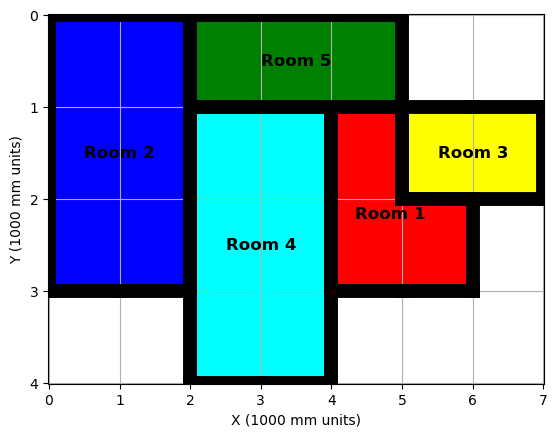

In [2]:
import matplotlib.pyplot as plt
import numpy as np

# Define the new grid structure
grid = np.array([
  [ 2,  2,  5,  5,  5, -1, -1],
  [ 2,  2,  4,  4,  1,  3,  3],
  [ 2,  2,  4,  4,  1,  1, -1],
  [-1, -1,  4,  4, -1, -1, -1]
])

# Define the scale
scale = 1000  # 1 unit = 1000mm
wall_thickness = 10  # Wall thickness in mm

# Create a plot
fig, ax = plt.subplots()

# Get the unique room identifiers and their corresponding colors
rooms = np.unique(grid)
colors = {
    0: 'white', 1: 'red', 2: 'blue', 3: 'yellow', 
    4: 'cyan', 5: 'green', -1: 'gray'
}

# Plot each room with the corresponding color
for room in rooms:
    if room != -1:  # Ignore external space
        room_coords = np.argwhere(grid == room)
        for coord in room_coords:
            y, x = coord
            rect = plt.Rectangle((x * scale, y * scale), scale, scale, facecolor=colors[room], edgecolor='black', linewidth=0)
            ax.add_patch(rect)

# Add thick borders for each room
for y in range(grid.shape[0]):
    for x in range(grid.shape[1]):
        if grid[y, x] != -1:
            if y == 0 or grid[y-1, x] != grid[y, x]:  # Top border
                ax.plot([x*scale, (x+1)*scale], [y*scale, y*scale], color='black', linewidth=wall_thickness)
            if y == grid.shape[0] - 1 or grid[y+1, x] != grid[y, x]:  # Bottom border
                ax.plot([x*scale, (x+1)*scale], [(y+1)*scale, (y+1)*scale], color='black', linewidth=wall_thickness)
            if x == 0 or grid[y, x-1] != grid[y, x]:  # Left border
                ax.plot([x*scale, x*scale], [y*scale, (y+1)*scale], color='black', linewidth=wall_thickness)
            if x == grid.shape[1] - 1 or grid[y, x+1] != grid[y, x]:  # Right border
                ax.plot([(x+1)*scale, (x+1)*scale], [y*scale, (y+1)*scale], color='black', linewidth=wall_thickness)

# Set labels and grid
ax.set_xticks(np.arange(0, (grid.shape[1] + 1) * scale, scale))
ax.set_yticks(np.arange(0, (grid.shape[0] + 1) * scale, scale))
ax.set_xticklabels(np.arange(0, grid.shape[1] + 1))
ax.set_yticklabels(np.arange(0, grid.shape[0] + 1))
plt.xlabel('X (1000 mm units)')
plt.ylabel('Y (1000 mm units)')
ax.grid(True)

# Add room labels
for room in rooms:
    if room > 0:
        room_coords = np.argwhere(grid == room)
        y_mean = np.mean(room_coords[:, 0]) * scale + scale / 2
        x_mean = np.mean(room_coords[:, 1]) * scale + scale / 2
        ax.text(x_mean, y_mean, f'Room {room}', color='black', weight='bold', 
                ha='center', va='center', fontsize=12)

# Adjust plot limits to account for wall thickness
ax.set_xlim(-wall_thickness, grid.shape[1] * scale + wall_thickness)
ax.set_ylim(-wall_thickness, grid.shape[0] * scale + wall_thickness)

# Display the plot
plt.gca().invert_yaxis()
plt.show()


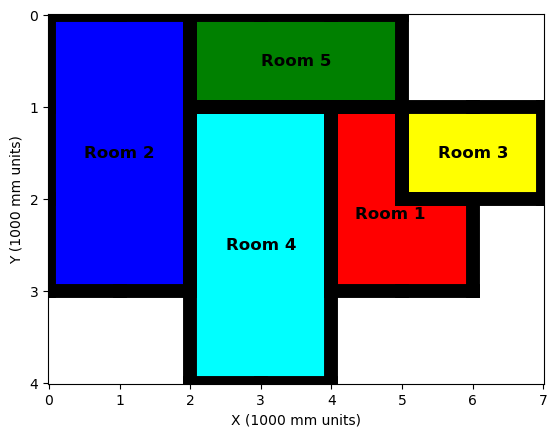

In [4]:
import matplotlib.pyplot as plt
import numpy as np

# Define the new grid structure
grid = np.array([
  [ 2,  2,  5,  5,  5, -1, -1],
  [ 2,  2,  4,  4,  1,  3,  3],
  [ 2,  2,  4,  4,  1,  1, -1],
  [-1, -1,  4,  4, -1, -1, -1]
])

# Define the scale
scale = 1000  # 1 unit = 1000mm
wall_thickness = 10  # Wall thickness in mm

# Create a plot
fig, ax = plt.subplots()

# Get the unique room identifiers and their corresponding colors
rooms = np.unique(grid)
colors = {
    0: 'white', 1: 'red', 2: 'blue', 3: 'yellow', 
    4: 'cyan', 5: 'green', -1: 'gray'
}

# Plot each room with the corresponding color
for room in rooms:
    if room != -1:  # Ignore external space
        room_coords = np.argwhere(grid == room)
        for coord in room_coords:
            y, x = coord
            rect = plt.Rectangle((x * scale, y * scale), scale, scale, facecolor=colors[room], edgecolor='black', linewidth=0)
            ax.add_patch(rect)

# Add thick borders for each room
for room in rooms:
    if room != -1:
        room_coords = np.argwhere(grid == room)
        for coord in room_coords:
            y, x = coord
            if x == 0 or grid[y, x-1] != room:
                ax.plot([x*scale, x*scale], [y*scale, (y+1)*scale], color='black', linewidth=wall_thickness)
            if x == grid.shape[1] - 1 or grid[y, x+1] != room:
                ax.plot([(x+1)*scale, (x+1)*scale], [y*scale, (y+1)*scale], color='black', linewidth=wall_thickness)
            if y == 0 or grid[y-1, x] != room:
                ax.plot([x*scale, (x+1)*scale], [y*scale, y*scale], color='black', linewidth=wall_thickness)
            if y == grid.shape[0] - 1 or grid[y+1, x] != room:
                ax.plot([x*scale, (x+1)*scale], [(y+1)*scale, (y+1)*scale], color='black', linewidth=wall_thickness)

# Set labels and grid
ax.set_xticks(np.arange(0, (grid.shape[1] + 1) * scale, scale))
ax.set_yticks(np.arange(0, (grid.shape[0] + 1) * scale, scale))
ax.set_xticklabels(np.arange(0, grid.shape[1] + 1))
ax.set_yticklabels(np.arange(0, grid.shape[0] + 1))
plt.xlabel('X (1000 mm units)')
plt.ylabel('Y (1000 mm units)')
ax.grid(False)  # Disable the grid

# Add room labels
for room in rooms:
    if room > 0:
        room_coords = np.argwhere(grid == room)
        y_mean = np.mean(room_coords[:, 0]) * scale + scale / 2
        x_mean = np.mean(room_coords[:, 1]) * scale + scale / 2
        ax.text(x_mean, y_mean, f'Room {room}', color='black', weight='bold', 
                ha='center', va='center', fontsize=12)

# Adjust plot limits to account for wall thickness
ax.set_xlim(-wall_thickness, grid.shape[1] * scale + wall_thickness)
ax.set_ylim(-wall_thickness, grid.shape[0] * scale + wall_thickness)

# Display the plot
plt.gca().invert_yaxis()
plt.show()


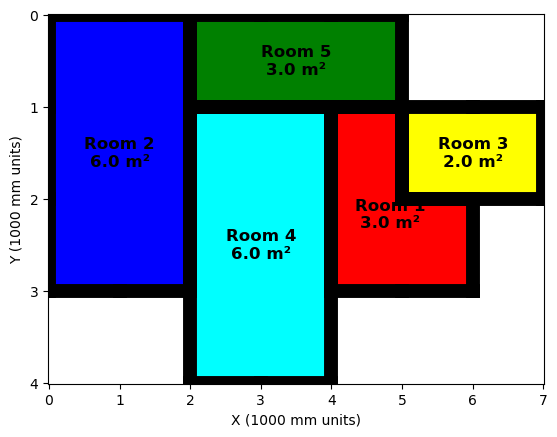

In [6]:
import matplotlib.pyplot as plt
import numpy as np

# Define the new grid structure
grid = np.array([
  [ 2,  2,  5,  5,  5, -1, -1],
  [ 2,  2,  4,  4,  1,  3,  3],
  [ 2,  2,  4,  4,  1,  1, -1],
  [-1, -1,  4,  4, -1, -1, -1]
])

# Define the scale
scale = 1000  # 1 unit = 1000mm
wall_thickness = 10  # Wall thickness in mm

# Create a plot
fig, ax = plt.subplots()

# Get the unique room identifiers and their corresponding colors
rooms = np.unique(grid)
colors = {
    0: 'white', 1: 'red', 2: 'blue', 3: 'yellow', 
    4: 'cyan', 5: 'green', -1: 'gray'
}

# Plot each room with the corresponding color
for room in rooms:
    if room != -1:  # Ignore external space
        room_coords = np.argwhere(grid == room)
        for coord in room_coords:
            y, x = coord
            rect = plt.Rectangle((x * scale, y * scale), scale, scale, facecolor=colors[room], edgecolor='black', linewidth=0)
            ax.add_patch(rect)

# Add thick borders for each room
for y in range(grid.shape[0]):
    for x in range(grid.shape[1]):
        if grid[y, x] != -1:
            if y == 0 or grid[y-1, x] != grid[y, x]:  # Top border
                ax.plot([x*scale, (x+1)*scale], [y*scale, y*scale], color='black', linewidth=wall_thickness)
            if y == grid.shape[0] - 1 or grid[y+1, x] != grid[y, x]:  # Bottom border
                ax.plot([x*scale, (x+1)*scale], [(y+1)*scale, (y+1)*scale], color='black', linewidth=wall_thickness)
            if x == 0 or grid[y, x-1] != grid[y, x]:  # Left border
                ax.plot([x*scale, x*scale], [y*scale, (y+1)*scale], color='black', linewidth=wall_thickness)
            if x == grid.shape[1] - 1 or grid[y, x+1] != grid[y, x]:  # Right border
                ax.plot([(x+1)*scale, (x+1)*scale], [y*scale, (y+1)*scale], color='black', linewidth=wall_thickness)

# Set labels and grid
ax.set_xticks(np.arange(0, (grid.shape[1] + 1) * scale, scale))
ax.set_yticks(np.arange(0, (grid.shape[0] + 1) * scale, scale))
ax.set_xticklabels(np.arange(0, grid.shape[1] + 1))
ax.set_yticklabels(np.arange(0, grid.shape[0] + 1))
plt.xlabel('X (1000 mm units)')
plt.ylabel('Y (1000 mm units)')
ax.grid(False)  # Disable the grid

# Add room labels
for room in rooms:
    if room > 0:
        room_coords = np.argwhere(grid == room)
        area_sqm = len(room_coords) * (scale / 1000) ** 2  # Calculate area in square meters
        y_mean = np.mean(room_coords[:, 0]) * scale + scale / 2
        x_mean = np.mean(room_coords[:, 1]) * scale + scale / 2
        ax.text(x_mean, y_mean, f'Room {room}\n{area_sqm:.1f} m²', color='black', weight='bold', 
                ha='center', va='center', fontsize=12)

# Adjust plot limits to account for wall thickness
ax.set_xlim(-wall_thickness, grid.shape[1] * scale + wall_thickness)
ax.set_ylim(-wall_thickness, grid.shape[0] * scale + wall_thickness)

# Display the plot
plt.gca().invert_yaxis()
plt.show()


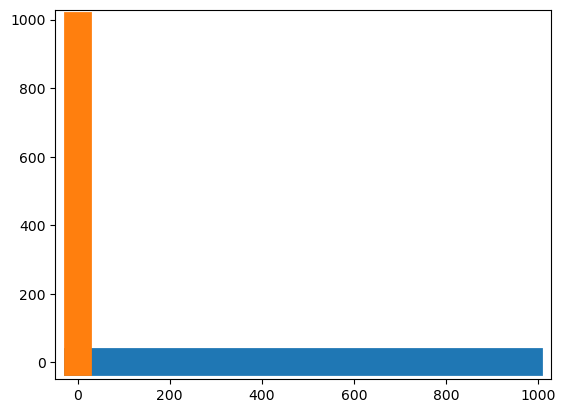

In [13]:
fig, ax = plt.subplots()
ax.plot([0,1000-20], [0,0], linewidth = 20)
ax.plot([0,0],[0,1000-20], linewidth=20)
plt.show()

In [15]:
!pip install ezdxf

  Obtaining dependency information for ezdxf from https://files.pythonhosted.org/packages/59/c1/053c46b6f02eec7d54ad876c4bdce1ef447e25cd99991c55fcf37e7fe5de/ezdxf-1.3.1-cp311-cp311-win_amd64.whl.metadata
   ---------------------------------------- 0.0/2.8 MB ? eta -:--:--
   ------------------ --------------------- 1.3/2.8 MB 41.0 MB/s eta 0:00:01
   ---------------------------------------  2.8/2.8 MB 44.9 MB/s eta 0:00:01
   ---------------------------------------  2.8/2.8 MB 44.9 MB/s eta 0:00:01
   ---------------------------------------- 2.8/2.8 MB 22.7 MB/s eta 0:00:00



[notice] A new release of pip is available: 23.2.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


In [16]:
import matplotlib.pyplot as plt
import numpy as np
import ezdxf

# Define the new grid structure
grid = np.array([
  [ 2,  2,  5,  5,  5, -1, -1],
  [ 2,  2,  4,  4,  1,  3,  3],
  [ 2,  2,  4,  4,  1,  1, -1],
  [-1, -1,  4,  4, -1, -1, -1]
])

# Add a border of -1 around the original grid
padded_grid = np.pad(grid, pad_width=1, mode='constant', constant_values=-1)

# Define the scale
scale = 1000  # 1 unit = 1000mm
wall_thickness = 5  # Wall thickness in mm

# Create a new DXF document
doc = ezdxf.new(dxfversion='R2010')
msp = doc.modelspace()

# Define colors (DXF uses ACI - AutoCAD Color Index)
aci_colors = {
    0: 7, 1: 1, 2: 5, 3: 2, 
    4: 4, 5: 3, -1: 8  # Default color for non-defined areas
}

# Plot each room with the corresponding color
for room in np.unique(padded_grid):
    if room != -1:  # Ignore external space
        room_coords = np.argwhere(padded_grid == room)
        for coord in room_coords:
            y, x = coord
            x1, y1 = x * scale, y * scale
            x2, y2 = (x + 1) * scale, (y + 1) * scale
            msp.add_lwpolyline([(x1, y1), (x2, y1), (x2, y2), (x1, y2), (x1, y1)], 
                               dxfattribs={'color': aci_colors[room]})

# Add thick borders for each room
for y in range(padded_grid.shape[0]):
    for x in range(padded_grid.shape[1]):
        if padded_grid[y, x] != -1:
            if y == 0 or padded_grid[y-1, x] != padded_grid[y, x]:  # Top border
                msp.add_line((x*scale, y*scale), ((x+1)*scale, y*scale), 
                             dxfattribs={'color': 7, 'lineweight': wall_thickness*10})
            if y == padded_grid.shape[0] - 1 or padded_grid[y+1, x] != padded_grid[y, x]:  # Bottom border
                msp.add_line((x*scale, (y+1)*scale), ((x+1)*scale, (y+1)*scale), 
                             dxfattribs={'color': 7, 'lineweight': wall_thickness*10})
            if x == 0 or padded_grid[y, x-1] != padded_grid[y, x]:  # Left border
                msp.add_line((x*scale, y*scale), (x*scale, (y+1)*scale), 
                             dxfattribs={'color': 7, 'lineweight': wall_thickness*10})
            if x == padded_grid.shape[1] - 1 or padded_grid[y, x+1] != padded_grid[y, x]:  # Right border
                msp.add_line(((x+1)*scale, y*scale), ((x+1)*scale, (y+1)*scale), 
                             dxfattribs={'color': 7, 'lineweight': wall_thickness*10})

# Save the DXF document
doc.saveas("./floorplan.dxf")

print("DXF file has been created.")


DXF file has been created.


In [19]:
import matplotlib.pyplot as plt
import numpy as np
import ezdxf

# Define the new grid structure
grid = np.array([
  [ 2,  2,  5,  5,  5, -1, -1],
  [ 2,  2,  4,  4,  1,  3,  3],
  [ 2,  2,  4,  4,  1,  1, -1],
  [-1, -1,  4,  4, -1, -1, -1]
])

# Add a border of -1 around the original grid
padded_grid = np.pad(grid, pad_width=1, mode='constant', constant_values=-1)

# Define the scale
scale = 1000  # 1 unit = 1000mm
wall_thickness = 5  # Wall thickness in mm

# Create a new DXF document
doc = ezdxf.new(dxfversion='R2010')
msp = doc.modelspace()

# Define colors (DXF uses ACI - AutoCAD Color Index)
aci_colors = {
    0: 7, 1: 1, 2: 5, 3: 2, 
    4: 4, 5: 3, -1: 8  # Default color for non-defined areas
}

# Plot each room with the corresponding color
for room in np.unique(padded_grid):
    if room != -1:  # Ignore external space
        room_coords = np.argwhere(padded_grid == room)
        for coord in room_coords:
            y, x = coord
            x1, y1 = x * scale, y * scale
            x2, y2 = (x + 1) * scale, (y + 1) * scale
            msp.add_lwpolyline([(x1, y1), (x2, y1), (x2, y2), (x1, y2), (x1, y1)], 
                               dxfattribs={'color': aci_colors[room]})

# Add thick borders for each room
for y in range(padded_grid.shape[0]):
    for x in range(padded_grid.shape[1]):
        if padded_grid[y, x] != -1:
            if y == 0 or padded_grid[y-1, x] != padded_grid[y, x]:  # Top border
                msp.add_line((x*scale, y*scale), ((x+1)*scale, y*scale), 
                             dxfattribs={'color': 7, 'lineweight': wall_thickness*10})
            if y == padded_grid.shape[0] - 1 or padded_grid[y+1, x] != padded_grid[y, x]:  # Bottom border
                msp.add_line((x*scale, (y+1)*scale), ((x+1)*scale, (y+1)*scale), 
                             dxfattribs={'color': 7, 'lineweight': wall_thickness*10})
            if x == 0 or padded_grid[y, x-1] != padded_grid[y, x]:  # Left border
                msp.add_line((x*scale, y*scale), (x*scale, (y+1)*scale), 
                             dxfattribs={'color': 7, 'lineweight': wall_thickness*10})
            if x == padded_grid.shape[1] - 1 or padded_grid[y, x+1] != padded_grid[y, x]:  # Right border
                msp.add_line(((x+1)*scale, y*scale), ((x+1)*scale, (y+1)*scale), 
                             dxfattribs={'color': 7, 'lineweight': wall_thickness*10})

# Save the DXF document
doc.saveas("floorplan_fixed.dxf")

print("DXF file has been created.")


DXF file has been created.


In [31]:
import numpy as np
import ezdxf

# Define the new grid structure
grid = np.array([
 [ 4,  4,  4,  4,  1, -1, -1],
 [ 2,  2,  4,  1,  1,  5,  5],
 [ 2,  2,  3,  3,  1,  5, -1],
 [-1, -1,  3,  3, -1, -1, -1]])
# Add a border of -1 around the original grid
padded_grid = np.pad(grid, pad_width=1, mode='constant', constant_values=-1)

# Define the scale
scale = 1000  # 1 unit = 1000mm
wall_thickness = 50  # Wall thickness in mm

# Create a new DXF document
doc = ezdxf.new(dxfversion='R2010')
msp = doc.modelspace()

# Function to add a thick border
def add_border(x1, y1, x2, y2):
    msp.add_line((x1, y1), (x2, y2), dxfattribs={'color': 7, 'lineweight': wall_thickness})

# Add thick borders for each room
for y in range(padded_grid.shape[0]):
    for x in range(padded_grid.shape[1]):
        if padded_grid[y, x] != -1:
            if y == 0 or padded_grid[y-1, x] != padded_grid[y, x]:  # Top border
                add_border(x*scale, y*scale, (x+1)*scale, y*scale)
            if y == padded_grid.shape[0] - 1 or padded_grid[y+1, x] != padded_grid[y, x]:  # Bottom border
                add_border(x*scale, (y+1)*scale, (x+1)*scale, (y+1)*scale)
            if x == 0 or padded_grid[y, x-1] != padded_grid[y, x]:  # Left border
                add_border(x*scale, y*scale, x*scale, (y+1)*scale)
            if x == padded_grid.shape[1] - 1 or padded_grid[y, x+1] != padded_grid[y, x]:  # Right border
                add_border((x+1)*scale, y*scale, (x+1)*scale, (y+1)*scale)

# Save the DXF document
doc.saveas("floorplan_borders_only.dxf")

print("DXF file has been created.")


DXF file has been created.


In [32]:
import matplotlib.pyplot as plt
import numpy as np
import ezdxf

# Define the grid structure
grid = np.array([
  [ 2,  2,  5,  5,  5, -1, -1],
  [ 2,  2,  4,  4,  1,  3,  3],
  [ 2,  2,  4,  4,  1,  1, -1],
  [-1, -1,  4,  4, -1, -1, -1]
])
grid = np.flipud(grid)
# Flip the grid along the y-axis to match the plot orientation
grid = np.flipud(grid)

# Define the scale
scale = 1000  # 1 unit = 1000mm
wall_thickness = 5  # Wall thickness in mm

# Create a new DXF document
doc = ezdxf.new(dxfversion='R2010')
msp = doc.modelspace()

# Define colors (DXF uses ACI - AutoCAD Color Index)
colors = {
    1: 1,   # red
    2: 5,   # blue
    3: 2,   # yellow
    4: 4,   # cyan
    5: 3,   # green
}

# Function to add a rectangle for each room
def add_rectangle(x1, y1, x2, y2, color):
    msp.add_lwpolyline(
        [(x1, y1), (x2, y1), (x2, y2), (x1, y2), (x1, y1)], 
        dxfattribs={'color': color, 'lineweight': wall_thickness}
    )

# Plot each room with the corresponding color
for y in range(grid.shape[0]):
    for x in range(grid.shape[1]):
        if grid[y, x] > 0:
            room = grid[y, x]
            color = colors[room]
            x1, y1 = x * scale, y * scale
            x2, y2 = (x + 1) * scale, (y + 1) * scale
            add_rectangle(x1, y1, x2, y2, color)

# Save the DXF document
doc.saveas("floorplan_match.png.dxf")

print("DXF file has been created.")


DXF file has been created.


In [30]:
import numpy as np
import ezdxf

# Define the grid structure
grid = np.array([
  [ 2,  2,  5,  5,  5, -1, -1],
  [ 2,  2,  4,  4,  1,  3,  3],
  [ 2,  2,  4,  4,  1,  1, -1],
  [-1, -1,  4,  4, -1, -1, -1]
])

# Flip the grid along the y-axis to match the plot orientation
grid = np.flipud(grid)

# Define the scale
scale = 1000  # 1 unit = 1000mm
wall_thickness = 5  # Wall thickness in mm

# Create a new DXF document
doc = ezdxf.new(dxfversion='R2010')
msp = doc.modelspace()

# Function to add a thick border
def add_border(x1, y1, x2, y2):
    msp.add_line((x1, y1), (x2, y2), dxfattribs={'color': 7, 'lineweight': wall_thickness})

# Add thick borders for each room
rows, cols = grid.shape
for y in range(rows):
    for x in range(cols):
        if grid[y, x] != -1:
            # Check top border
            if y == 0 or grid[y-1, x] != grid[y, x]:
                add_border(x*scale, y*scale, (x+1)*scale, y*scale)
            # Check bottom border
            if y == rows-1 or grid[y+1, x] != grid[y, x]:
                add_border(x*scale, (y+1)*scale, (x+1)*scale, (y+1)*scale)
            # Check left border
            if x == 0 or grid[y, x-1] != grid[y, x]:
                add_border(x*scale, y*scale, x*scale, (y+1)*scale)
            # Check right border
            if x == cols-1 or grid[y, x+1] != grid[y, x]:
                add_border((x+1)*scale, y*scale, (x+1)*scale, (y+1)*scale)

# Save the DXF document
doc.saveas("floorplan_match_borders_only.dxf")

print("DXF file has been created.")


DXF file has been created.


In [34]:
import numpy as np
import ezdxf

# Define the new grid structure
grid = np.array([
 [ 4,  4,  4,  4,  1, -1, -1],
 [ 2,  2,  4,  1,  1,  5,  5],
 [ 2,  2,  3,  3,  1,  5, -1],
 [-1, -1,  3,  3, -1, -1, -1]])
grid = np.flipud(grid)
# Add a border of -1 around the original grid
padded_grid = np.pad(grid, pad_width=1, mode='constant', constant_values=-1)

# Define the scale
scale = 1000  # 1 unit = 1000mm
wall_thickness = 50  # Wall thickness in mm

# Create a new DXF document
doc = ezdxf.new(dxfversion='R2010')
msp = doc.modelspace()

# Function to add a thick border
def add_border(x1, y1, x2, y2):
    msp.add_line((x1, y1), (x2, y2), dxfattribs={'color': 7, 'lineweight': wall_thickness})

# Add thick borders for each room
for y in range(padded_grid.shape[0]):
    for x in range(padded_grid.shape[1]):
        if padded_grid[y, x] != -1:
            if y == 0 or padded_grid[y-1, x] != padded_grid[y, x]:  # Top border
                add_border(x*scale, y*scale, (x+1)*scale, y*scale)
            if y == padded_grid.shape[0] - 1 or padded_grid[y+1, x] != padded_grid[y, x]:  # Bottom border
                add_border(x*scale, (y+1)*scale, (x+1)*scale, (y+1)*scale)
            if x == 0 or padded_grid[y, x-1] != padded_grid[y, x]:  # Left border
                add_border(x*scale, y*scale, x*scale, (y+1)*scale)
            if x == padded_grid.shape[1] - 1 or padded_grid[y, x+1] != padded_grid[y, x]:  # Right border
                add_border((x+1)*scale, y*scale, (x+1)*scale, (y+1)*scale)

# Save the DXF document
doc.saveas("floorplan.dxf")

print("DXF file has been created.")

DXF file has been created.


In [38]:
import numpy as np
import ezdxf

# Define the new grid structure
grid = np.array([
 [ 4,  4,  4,  4,  1, -1, -1],
 [ 2,  2,  4,  1,  1,  5,  5],
 [ 2,  2,  3,  3,  1,  5, -1],
 [-1, -1,  3,  3, -1, -1, -1]])
grid = np.flipud(grid)

# Add a border of -1 around the original grid
padded_grid = np.pad(grid, pad_width=1, mode='constant', constant_values=-1)

# Define the scale
scale = 1000  # 1 unit = 1000mm
wall_thickness = 50  # Wall thickness in mm
offset = 50  # Offset for double lines

# Create a new DXF document
doc = ezdxf.new(dxfversion='R2010')
msp = doc.modelspace()

# Function to add a thick border
def add_border(x1, y1, x2, y2, offset=0):
    msp.add_line((x1, y1), (x2, y2), dxfattribs={'color': 7, 'lineweight': wall_thickness})
    if offset != 0:
        if x1 == x2:  # Vertical line
            msp.add_line((x1 + offset, y1), (x2 + offset, y2), dxfattribs={'color': 7, 'lineweight': wall_thickness})
            msp.add_line((x1 - offset, y1), (x2 - offset, y2), dxfattribs={'color': 7, 'lineweight': wall_thickness})
        elif y1 == y2:  # Horizontal line
            msp.add_line((x1, y1 + offset), (x2, y2 + offset), dxfattribs={'color': 7, 'lineweight': wall_thickness})
            msp.add_line((x1, y1 - offset), (x2, y2 - offset), dxfattribs={'color': 7, 'lineweight': wall_thickness})

# Add thick borders for each room
rows, cols = padded_grid.shape
for y in range(rows):
    for x in range(cols):
        if padded_grid[y, x] != -1:
            # Check top border
            if y == 0 or padded_grid[y-1, x] != padded_grid[y, x]:
                add_border(x*scale, y*scale, (x+1)*scale, y*scale, offset)
            # Check bottom border
            if y == rows-1 or padded_grid[y+1, x] != padded_grid[y, x]:
                add_border(x*scale, (y+1)*scale, (x+1)*scale, (y+1)*scale, offset)
            # Check left border
            if x == 0 or padded_grid[y, x-1] != padded_grid[y, x]:
                add_border(x*scale, y*scale, x*scale, (y+1)*scale, offset)
            # Check right border
            if x == cols-1 or padded_grid[y, x+1] != padded_grid[y, x]:
                add_border((x+1)*scale, y*scale, (x+1)*scale, (y+1)*scale, offset)

# Save the DXF document
doc.saveas("floorplan_double_lines.dxf")

print("DXF file has been created.")


DXF file has been created.


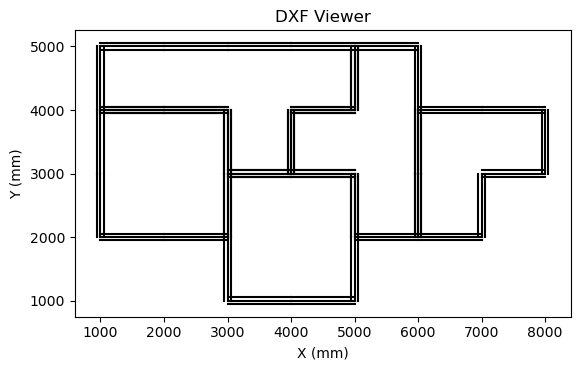

In [39]:
import ezdxf
import matplotlib.pyplot as plt

def plot_dxf(filename):
    # Load the DXF document
    doc = ezdxf.readfile(filename)
    msp = doc.modelspace()

    # Extract the lines from the DXF
    lines = []
    for entity in msp:
        if entity.dxftype() == 'LINE':
            start = entity.dxf.start
            end = entity.dxf.end
            lines.append(((start.x, start.y), (end.x, end.y)))

    # Plot the DXF content
    fig, ax = plt.subplots()
    for line in lines:
        (x1, y1), (x2, y2) = line
        ax.plot([x1, x2], [y1, y2], color='black')

    ax.set_aspect('equal')
    plt.xlabel('X (mm)')
    plt.ylabel('Y (mm)')
    plt.title('DXF Viewer')
    plt.show()

# Plot the DXF file
plot_dxf('floorplan_double_lines.dxf')  

In [40]:
# 이중라인의 끝과 끝이 정확히 맞물리도록
import numpy as np
import ezdxf

# Define the new grid structure
grid = np.array([
 [ 4,  4,  4,  4,  1, -1, -1],
 [ 2,  2,  4,  1,  1,  5,  5],
 [ 2,  2,  3,  3,  1,  5, -1],
 [-1, -1,  3,  3, -1, -1, -1]])
grid = np.flipud(grid)

# Add a border of -1 around the original grid
padded_grid = np.pad(grid, pad_width=1, mode='constant', constant_values=-1)

# Define the scale
scale = 1000  # 1 unit = 1000mm
wall_thickness = 50  # Wall thickness in mm
offset = 100  # Offset for double lines

# Create a new DXF document
doc = ezdxf.new(dxfversion='R2010')
msp = doc.modelspace()

# Function to add a thick border with adjusted endpoints
def add_border(x1, y1, x2, y2, offset=0):
    msp.add_line((x1, y1), (x2, y2), dxfattribs={'color': 7, 'lineweight': wall_thickness})
    print(f'(x1,y1) = {x1}, {y1},(x2, y2)= {x2}, {y2}')
    if offset != 0:
        if x1 == x2:  # Vertical line
            msp.add_line((x1 + offset, y1 - offset), (x2 + offset, y2 + offset), dxfattribs={'color': 7, 'lineweight': wall_thickness})
            print(f'x1==x1: Vertical line (x1 + offset, y1) = {x1 + offset}, {y1},(x2 + offset, y2)= {x2 + offset}, {y2})')
            msp.add_line((x1 - offset, y1 - offset), (x2 - offset, y2 + offset), dxfattribs={'color': 7, 'lineweight': wall_thickness})
            print(f'x1==x1: Vertical line (x1 - offset, y1-offset) = {x1 - offset}, {y1  -  offset},(x2 - offset, y2 + offset)= {x2 - offset}, {y2 + offset})')
        elif y1 == y2:  # Horizontal line
            msp.add_line((x1 - offset, y1 + offset), (x2 + offset, y2 + offset), dxfattribs={'color': 7, 'lineweight': wall_thickness})
            msp.add_line((x1 - offset, y1 - offset), (x2 + offset, y2 - offset), dxfattribs={'color': 7, 'lineweight': wall_thickness})

# Add thick borders for each room
rows, cols = padded_grid.shape
for y in range(rows):
    for x in range(cols):
        if padded_grid[y, x] != -1:
            # Check top border
            if y == 0 or padded_grid[y-1, x] != padded_grid[y, x]:
                add_border(x*scale, y*scale, (x+1)*scale, y*scale, offset)
            # Check bottom border
            if y == rows-1 or padded_grid[y+1, x] != padded_grid[y, x]:
                add_border(x*scale, (y+1)*scale, (x+1)*scale, (y+1)*scale, offset)
            # Check left border
            if x == 0 or padded_grid[y, x-1] != padded_grid[y, x]:
                add_border(x*scale, y*scale, x*scale, (y+1)*scale, offset)
            # Check right border
            if x == cols-1 or padded_grid[y, x+1] != padded_grid[y, x]:
                add_border((x+1)*scale, y*scale, (x+1)*scale, (y+1)*scale, offset)

# Save the DXF document
doc.saveas("floorplan_adjusted_lines.dxf")

print("DXF file has been created.")


DXF file has been created.


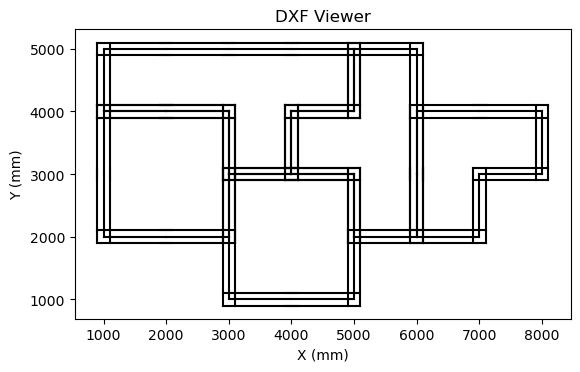

In [42]:
plot_dxf('floorplan_adjusted_lines.dxf')

In [49]:
# 안쪽 선도 맞물리게
import numpy as np
import ezdxf

# Define the new grid structure
grid = np.array([
 [ 4,  4,  4,  4,  1, -1, -1],
 [ 2,  2,  4,  1,  1,  5,  5],
 [ 2,  2,  3,  3,  1,  5, -1],
 [-1, -1,  3,  3, -1, -1, -1]])
grid = np.flipud(grid)

# Add a border of -1 around the original grid
padded_grid = np.pad(grid, pad_width=1, mode='constant', constant_values=-1)

# Define the scale
scale = 1000  # 1 unit = 1000mm
wall_thickness = 50  # Wall thickness in mm
offset = 100  # Offset for double lines

# Create a new DXF document
doc = ezdxf.new(dxfversion='R2010')
msp = doc.modelspace()

# Function to add a thick border with adjusted endpoints
def add_border(x1, y1, x2, y2, is_inner=False):
    msp.add_line((x1, y1), (x2, y2), dxfattribs={'color': 7, 'lineweight': wall_thickness})
    print(f'(x1,y1) = {x1}, {y1},(x2, y2)= {x2}, {y2}')
    print(f'(x1,y1) = {x1}, {y1},(x2, y2)= {x2}, {y2}')
    if is_inner:
        if x1 == x2:  # Vertical line
            msp.add_line((x1 + offset, y1), (x2 + offset, y2), dxfattribs={'color': 7, 'lineweight': wall_thickness})
            print(f'x1==x1: Vertical line (x1 + offset, y1) = {x1 + offset}, {y1},(x2 + offset, y2)= {x2 + offset}, {y2})')
        elif y1 == y2:  # Horizontal line
            msp.add_line((x1, y1 + offset), (x2, y2 + offset), dxfattribs={'color': 7, 'lineweight': wall_thickness})
    else:
        if x1 == x2:  # Vertical line
            msp.add_line((x1 - offset, y1), (x2 - offset, y2), dxfattribs={'color': 7, 'lineweight': wall_thickness})
        elif y1 == y2:  # Horizontal line
            msp.add_line((x1, y1 - offset), (x2, y2 - offset), dxfattribs={'color': 7, 'lineweight': wall_thickness})

# Add thick borders for each room
rows, cols = padded_grid.shape
for y in range(rows):
    for x in range(cols):
        if padded_grid[y, x] != -1:
            # Check top border
            if y == 0 or padded_grid[y-1, x] != padded_grid[y, x]:
                add_border(x*scale, y*scale, (x+1)*scale, y*scale, is_inner=True)
            # Check bottom border
            if y == rows-1 or padded_grid[y+1, x] != padded_grid[y, x]:
                add_border(x*scale, (y+1)*scale, (x+1)*scale, (y+1)*scale, is_inner=True)
            # Check left border
            if x == 0 or padded_grid[y, x-1] != padded_grid[y, x]:
                add_border(x*scale, y*scale, x*scale, (y+1)*scale, is_inner=True)
            # Check right border
            if x == cols-1 or padded_grid[y, x+1] != padded_grid[y, x]:
                add_border((x+1)*scale, y*scale, (x+1)*scale, (y+1)*scale, is_inner=True)

# Save the DXF document
doc.saveas("floorplan_corrected_interior.dxf")

print("DXF file has been created.")


(x1,y1) = 3000, 1000,(x2, y2)= 4000, 1000
(x1,y1) = 3000, 1000,(x2, y2)= 4000, 1000
(x1,y1) = 3000, 1000,(x2, y2)= 3000, 2000
(x1,y1) = 3000, 1000,(x2, y2)= 3000, 2000
x1==x1: Vertical line (x1 + offset, y1) = 3100, 1000,(x2 + offset, y2)= 3100, 2000)
(x1,y1) = 4000, 1000,(x2, y2)= 5000, 1000
(x1,y1) = 4000, 1000,(x2, y2)= 5000, 1000
(x1,y1) = 5000, 1000,(x2, y2)= 5000, 2000
(x1,y1) = 5000, 1000,(x2, y2)= 5000, 2000
x1==x1: Vertical line (x1 + offset, y1) = 5100, 1000,(x2 + offset, y2)= 5100, 2000)
(x1,y1) = 1000, 2000,(x2, y2)= 2000, 2000
(x1,y1) = 1000, 2000,(x2, y2)= 2000, 2000
(x1,y1) = 1000, 2000,(x2, y2)= 1000, 3000
(x1,y1) = 1000, 2000,(x2, y2)= 1000, 3000
x1==x1: Vertical line (x1 + offset, y1) = 1100, 2000,(x2 + offset, y2)= 1100, 3000)
(x1,y1) = 2000, 2000,(x2, y2)= 3000, 2000
(x1,y1) = 2000, 2000,(x2, y2)= 3000, 2000
(x1,y1) = 3000, 2000,(x2, y2)= 3000, 3000
(x1,y1) = 3000, 2000,(x2, y2)= 3000, 3000
x1==x1: Vertical line (x1 + offset, y1) = 3100, 2000,(x2 + offset, y2)= 3100

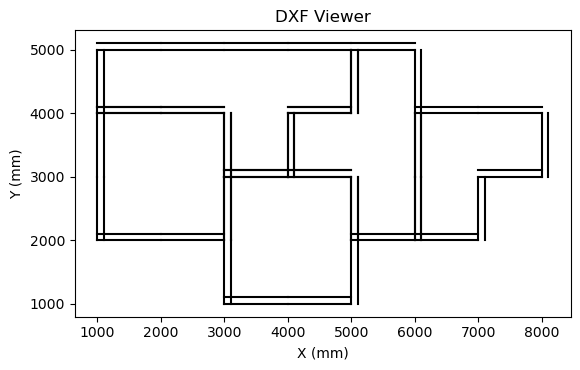

In [50]:
plot_dxf('floorplan_corrected_interior.dxf')

In [47]:
import numpy as np
import ezdxf

# Define the new grid structure
grid = np.array([
 [ 4,  4,  4,  4,  1, -1, -1],
 [ 2,  2,  4,  1,  1,  5,  5],
 [ 2,  2,  3,  3,  1,  5, -1],
 [-1, -1,  3,  3, -1, -1, -1]])
grid = np.flipud(grid)

# Add a border of -1 around the original grid
padded_grid = np.pad(grid, pad_width=1, mode='constant', constant_values=-1)

# Define the scale
scale = 1000  # 1 unit = 1000mm
wall_thickness = 50  # Wall thickness in mm
offset = 100  # Offset for double lines

# Create a new DXF document
doc = ezdxf.new(dxfversion='R2010')
msp = doc.modelspace()

# Function to add a thick border with adjusted endpoints
def add_border(x1, y1, x2, y2, offset=0, is_outer=True):
    msp.add_line((x1, y1), (x2, y2), dxfattribs={'color': 7, 'lineweight': wall_thickness})
    if offset != 0:
        if x1 == x2:  # Vertical line
            if is_outer:
                msp.add_line((x1 - offset, y1), (x2 - offset, y2), dxfattribs={'color': 7, 'lineweight': wall_thickness})
            else:
                msp.add_line((x1 + offset, y1), (x2 + offset, y2), dxfattribs={'color': 7, 'lineweight': wall_thickness})
        elif y1 == y2:  # Horizontal line
            if is_outer:
                msp.add_line((x1, y1 - offset), (x2, y2 - offset), dxfattribs={'color': 7, 'lineweight': wall_thickness})
            else:
                msp.add_line((x1, y1 + offset), (x2, y2 + offset), dxfattribs={'color': 7, 'lineweight': wall_thickness})

# Add thick borders for each room
rows, cols = padded_grid.shape
for y in range(rows):
    for x in range(cols):
        if padded_grid[y, x] != -1:
            # Check top border
            if y == 0 or padded_grid[y-1, x] != padded_grid[y, x]:
                add_border(x*scale, y*scale, (x+1)*scale, y*scale, offset, is_outer=True)
                add_border(x*scale, y*scale, (x+1)*scale, y*scale, offset, is_outer=False)
            # Check bottom border
            if y == rows-1 or padded_grid[y+1, x] != padded_grid[y, x]:
                add_border(x*scale, (y+1)*scale, (x+1)*scale, (y+1)*scale, offset, is_outer=True)
                add_border(x*scale, (y+1)*scale, (x+1)*scale, (y+1)*scale, offset, is_outer=False)
            # Check left border
            if x == 0 or padded_grid[y, x-1] != padded_grid[y, x]:
                add_border(x*scale, y*scale, x*scale, (y+1)*scale, offset, is_outer=True)
                add_border(x*scale, y*scale, x*scale, (y+1)*scale, offset, is_outer=False)
            # Check right border
            if x == cols-1 or padded_grid[y, x+1] != padded_grid[y, x]:
                add_border((x+1)*scale, y*scale, (x+1)*scale, (y+1)*scale, offset, is_outer=True)
                add_border((x+1)*scale, y*scale, (x+1)*scale, (y+1)*scale, offset, is_outer=False)

# Save the DXF document
doc.saveas("floorplan_corrected_inner.dxf")

print("DXF file has been created.")


DXF file has been created.


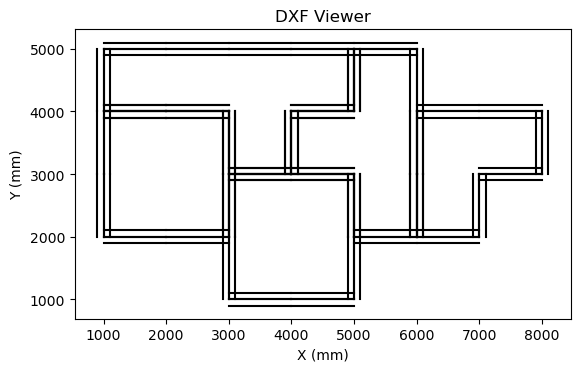

In [48]:
plot_dxf('floorplan_corrected_inner.dxf')

In [51]:
# 안쪽 선도 맞물리게
import numpy as np
import ezdxf

# Define the new grid structure
grid = np.array([
 [ 4,  4,  4,  4,  1, -1, -1],
 [ 2,  2,  4,  1,  1,  5,  5],
 [ 2,  2,  3,  3,  1,  5, -1],
 [-1, -1,  3,  3, -1, -1, -1]])
grid = np.flipud(grid)

# Add a border of -1 around the original grid
padded_grid = np.pad(grid, pad_width=1, mode='constant', constant_values=-1)

# Define the scale
scale = 1000  # 1 unit = 1000mm
wall_thickness = 50  # Wall thickness in mm
offset = 100  # Offset for double lines

# Create a new DXF document
doc = ezdxf.new(dxfversion='R2010')
msp = doc.modelspace()

# Function to add a thick border with adjusted endpoints
def add_border(x1, y1, x2, y2, is_inner=False):
    msp.add_line((x1, y1), (x2, y2), dxfattribs={'color': 7, 'lineweight': wall_thickness})
    print(f'(x1,y1) = {x1}, {y1},(x2, y2)= {x2}, {y2}')
    if is_inner:
        if x1 == x2:  # Vertical line
            msp.add_line((x1 + offset, y1), (x2 + offset, y2), dxfattribs={'color': 7, 'lineweight': wall_thickness})
            print(f'x1==x1: Vertical line (x1 + offset, y1) = {x1 + offset}, {y1},(x2 + offset, y2)= {x2 + offset}, {y2})')
        elif y1 == y2:  # Horizontal line
            msp.add_line((x1, y1 + offset), (x2, y2 + offset), dxfattribs={'color': 7, 'lineweight': wall_thickness})
    else:
        if x1 == x2:  # Vertical line
            msp.add_line((x1 - offset, y1), (x2 - offset, y2), dxfattribs={'color': 7, 'lineweight': wall_thickness})
        elif y1 == y2:  # Horizontal line
            msp.add_line((x1, y1 - offset), (x2, y2 - offset), dxfattribs={'color': 7, 'lineweight': wall_thickness})

# Add thick borders for each room
rows, cols = padded_grid.shape
for y in range(rows):
    for x in range(cols):
        if padded_grid[y, x] != -1:
            # Check top border
            if y == 0 or padded_grid[y-1, x] != padded_grid[y, x]:
                add_border(x*scale, y*scale, (x+1)*scale, y*scale, is_inner=True)
            # Check bottom border
            if y == rows-1 or padded_grid[y+1, x] != padded_grid[y, x]:
                add_border(x*scale, (y+1)*scale, (x+1)*scale, (y+1)*scale, is_inner=True)
            # Check left border
            if x == 0 or padded_grid[y, x-1] != padded_grid[y, x]:
                add_border(x*scale, y*scale, x*scale, (y+1)*scale, is_inner=True)
            # Check right border
            if x == cols-1 or padded_grid[y, x+1] != padded_grid[y, x]:
                add_border((x+1)*scale, y*scale, (x+1)*scale, (y+1)*scale, is_inner=True)

# Save the DXF document
doc.saveas("floorplan_corrected_interior.dxf")

print("DXF file has been created.")

(x1,y1) = 3000, 1000,(x2, y2)= 4000, 1000
(x1,y1) = 3000, 1000,(x2, y2)= 4000, 1000
(x1,y1) = 3000, 1000,(x2, y2)= 3000, 2000
(x1,y1) = 3000, 1000,(x2, y2)= 3000, 2000
x1==x1: Vertical line (x1 + offset, y1) = 3100, 1000,(x2 + offset, y2)= 3100, 2000)
(x1,y1) = 4000, 1000,(x2, y2)= 5000, 1000
(x1,y1) = 4000, 1000,(x2, y2)= 5000, 1000
(x1,y1) = 5000, 1000,(x2, y2)= 5000, 2000
(x1,y1) = 5000, 1000,(x2, y2)= 5000, 2000
x1==x1: Vertical line (x1 + offset, y1) = 5100, 1000,(x2 + offset, y2)= 5100, 2000)
(x1,y1) = 1000, 2000,(x2, y2)= 2000, 2000
(x1,y1) = 1000, 2000,(x2, y2)= 2000, 2000
(x1,y1) = 1000, 2000,(x2, y2)= 1000, 3000
(x1,y1) = 1000, 2000,(x2, y2)= 1000, 3000
x1==x1: Vertical line (x1 + offset, y1) = 1100, 2000,(x2 + offset, y2)= 1100, 3000)
(x1,y1) = 2000, 2000,(x2, y2)= 3000, 2000
(x1,y1) = 2000, 2000,(x2, y2)= 3000, 2000
(x1,y1) = 3000, 2000,(x2, y2)= 3000, 3000
(x1,y1) = 3000, 2000,(x2, y2)= 3000, 3000
x1==x1: Vertical line (x1 + offset, y1) = 3100, 2000,(x2 + offset, y2)= 3100

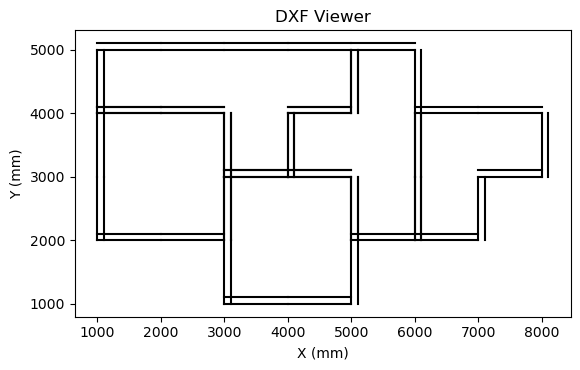

In [52]:
plot_dxf('floorplan_corrected_interior.dxf')

## ezdxf color index 
 NAME                        | VALUE |
-----------------------------|-------|
| BYBLOCK                     | 0|     
 | BYLAYER                     | 256|   
 | BYOBJECT                    | 257|   
 | RED                         | 1|     
 | YELLOW                      | 2|     
 | GREEN                       | 3|     
 | CYAN                        | 4|     
 | BLUE                        | 5|     
 | MAGENTA                     | 6|     
 | BLACK (on light background) | 7|     
 | WHITE (on dark background)  | 7|     
 | GRAY                        | 8|     
 | LIGHT_GRAY                  | 9|     

DXF file has been created.


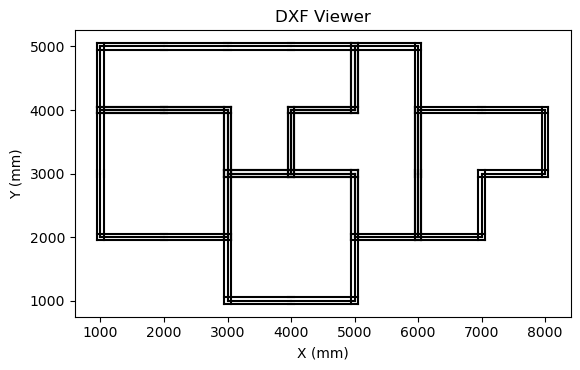

In [63]:
# 이중라인의 끝과 끝이 정확히 맞물리도록
import numpy as np
import ezdxf

# Define the new grid structure
grid = np.array([
 [ 4,  4,  4,  4,  1, -1, -1],
 [ 2,  2,  4,  1,  1,  5,  5],
 [ 2,  2,  3,  3,  1,  5, -1],
 [-1, -1,  3,  3, -1, -1, -1]])
grid = np.flipud(grid)

# Add a border of -1 around the original grid
padded_grid = np.pad(grid, pad_width=1, mode='constant', constant_values=-1)

# Define the scale
scale = 1000  # 1 unit = 1000mm
wall_thickness = 50  # Wall thickness in mm
offset = 50  # Offset for double lines

# Create a new DXF document
doc = ezdxf.new(dxfversion='R2010')
msp = doc.modelspace()

# Function to add a thick border with adjusted endpoints
def add_border(x1, y1, x2, y2, offset=0):
    msp.add_line((x1, y1), (x2, y2), dxfattribs={'color': 7, 'lineweight': wall_thickness})
    # print(f'(x1,y1) = {x1}, {y1},(x2, y2)= {x2}, {y2}')
    if offset != 0:
        if x1 == x2:  # Vertical line
            msp.add_line((x1 + offset, y1 - offset), (x2 + offset, y2 + offset), dxfattribs={'color': 4, 'lineweight': wall_thickness}) #4:cyon
            # print(f'x1==x1: Vertical line (x1 + offset, y1) = ({x1 + offset}, {y1}),(x2 + offset, y2)= ({x2 + offset}, {y2})')
            
            if x1 == 0 and x2 == 0:
                 msp.add_line((x1 - offset, y1 - offset), (x2 - offset, y2 + offset), dxfattribs={'color': 1, 'lineweight': wall_thickness}) # color=2: yellow for debug 1:red
                 print(f'(x1, x2)=({x1}, {x2})')
            else:
                msp.add_line((x1 - offset, y1 - offset), (x2 - offset, y2 + offset), dxfattribs={'color': 2, 'lineweight': wall_thickness}) # color=2: yellow for debug
            # print(f'x1==x1: Vertical line (x1 - offset, y1-offset) = {x1 - offset}, {y1  -  offset},(x2 - offset, y2 + offset)= {x2 - offset}, {y2 + offset})')
                
        elif y1 == y2:  # Horizontal line
            msp.add_line((x1 - offset, y1 + offset), (x2 + offset, y2 + offset), dxfattribs={'color': 5, 'lineweight': wall_thickness})
            msp.add_line((x1 - offset, y1 - offset), (x2 + offset, y2 - offset), dxfattribs={'color': 3, 'lineweight': wall_thickness})#green

# Add thick borders for each room
rows, cols = padded_grid.shape
for y in range(rows):
    for x in range(cols):
        if padded_grid[y, x] != -1:
            # Check top border
            if y == 0 or padded_grid[y-1, x] != padded_grid[y, x]:
                add_border(x*scale, y*scale, (x+1)*scale, y*scale, offset)
            # Check bottom border
            if y == rows-1 or padded_grid[y+1, x] != padded_grid[y, x]:
                add_border(x*scale, (y+1)*scale, (x+1)*scale, (y+1)*scale, offset)
            # Check left border
            if x == 0 or padded_grid[y, x-1] != padded_grid[y, x]:
                add_border(x*scale, y*scale, x*scale, (y+1)*scale, offset)
            # Check right border
            if x == cols-1 or padded_grid[y, x+1] != padded_grid[y, x]:
                add_border((x+1)*scale, y*scale, (x+1)*scale, (y+1)*scale, offset)

# Save the DXF document
doc.saveas("floorplan.dxf")

print("DXF file has been created.")
plot_dxf('floorplan.dxf')

In [64]:
import numpy as np
import ezdxf

# Define the new grid structure
grid = np.array([
 [ 4,  4,  4,  4,  1, -1, -1],
 [ 2,  2,  4,  1,  1,  5,  5],
 [ 2,  2,  3,  3,  1,  5, -1],
 [-1, -1,  3,  3, -1, -1, -1]])
grid = np.flipud(grid)

# Add a border of -1 around the original grid
padded_grid = np.pad(grid, pad_width=1, mode='constant', constant_values=-1)

# Define the scale
scale = 1000  # 1 unit = 1000mm
wall_thickness = 50  # Wall thickness in mm
offset = 50  # Offset for double lines

# Create a new DXF document
doc = ezdxf.new(dxfversion='R2010')
msp = doc.modelspace()

# Function to add a thick border with adjusted endpoints
def add_border(x1, y1, x2, y2, is_edge=False):
    msp.add_line((x1, y1), (x2, y2), dxfattribs={'color': 7, 'lineweight': wall_thickness})
    if x1 == x2:  # Vertical line
        if is_edge:
            msp.add_line((x1 + offset, y1), (x2 + offset, y2), dxfattribs={'color': 1, 'lineweight': wall_thickness})
            msp.add_line((x1 - offset, y1), (x2 - offset, y2), dxfattribs={'color': 1, 'lineweight': wall_thickness})
        else:
            msp.add_line((x1 + offset, y1 + offset), (x2 + offset, y2 - offset), dxfattribs={'color': 4, 'lineweight': wall_thickness})
            msp.add_line((x1 - offset, y1 + offset), (x2 - offset, y2 - offset), dxfattribs={'color': 2, 'lineweight': wall_thickness})
    elif y1 == y2:  # Horizontal line
        if is_edge:
            msp.add_line((x1, y1 + offset), (x2, y2 + offset), dxfattribs={'color': 1, 'lineweight': wall_thickness})
            msp.add_line((x1, y1 - offset), (x2, y2 - offset), dxfattribs={'color': 1, 'lineweight': wall_thickness})
        else:
            msp.add_line((x1 + offset, y1 + offset), (x2 - offset, y2 + offset), dxfattribs={'color': 5, 'lineweight': wall_thickness})
            msp.add_line((x1 + offset, y1 - offset), (x2 - offset, y2 - offset), dxfattribs={'color': 3, 'lineweight': wall_thickness})

# Add thick borders for each room
rows, cols = padded_grid.shape
for y in range(rows):
    for x in range(cols):
        if padded_grid[y, x] != -1:
            # Check if it is on the edge of the grid
            is_edge = (x == 0 or x == cols-1 or y == 0 or y == rows-1)
            # Check top border
            if y == 0 or padded_grid[y-1, x] != padded_grid[y, x]:
                add_border(x*scale, y*scale, (x+1)*scale, y*scale, is_edge)
            # Check bottom border
            if y == rows-1 or padded_grid[y+1, x] != padded_grid[y, x]:
                add_border(x*scale, (y+1)*scale, (x+1)*scale, (y+1)*scale, is_edge)
            # Check left border
            if x == 0 or padded_grid[y, x-1] != padded_grid[y, x]:
                add_border(x*scale, y*scale, x*scale, (y+1)*scale, is_edge)
            # Check right border
            if x == cols-1 or padded_grid[y, x+1] != padded_grid[y, x]:
                add_border((x+1)*scale, y*scale, (x+1)*scale, (y+1)*scale, is_edge)

# Save the DXF document
doc.saveas("floorplan.dxf")

print("DXF file has been created.")


DXF file has been created.


# 그리드를 dxf 파일로 변환 
- 벽체를 더블라인으로 표시하고, 가장자리를 붉은 색으로 칠하려고 하는데 잘 못함

In [69]:
import numpy as np
import ezdxf

# Define the new grid structure
grid = np.array([
 [ 4,  4,  4,  4,  1, -1, -1],
 [ 2,  2,  4,  1,  1,  5,  5],
 [ 2,  2,  3,  3,  1,  5, -1],
 [-1, -1,  3,  3, -1, -1, -1]])
grid = np.flipud(grid)

# Add a border of -1 around the original grid
padding = 1
padded_grid = np.pad(grid, pad_width=padding, mode='constant', constant_values=-1)

# Define the scale
scale = 1000  # 1 unit = 1000mm
wall_thickness = 200  # Wall thickness in mm
offset = 5  # Offset for double lines

# Create a new DXF document
doc = ezdxf.new(dxfversion='R2010')
msp = doc.modelspace()

# Function to add a thick border with adjusted endpoints
def add_border(x1, y1, x2, y2, is_edge=False):
    msp.add_line((x1, y1), (x2, y2), dxfattribs={'color': 7, 'lineweight': wall_thickness})
    if x1 == x2:  # Vertical line
        if is_edge:
            msp.add_line((x1 + offset, y1), (x2 + offset, y2), dxfattribs={'color': 1, 'lineweight': wall_thickness}) #1:red
            msp.add_line((x1 - offset, y1), (x2 - offset, y2), dxfattribs={'color': 1, 'lineweight': wall_thickness})
        else:
            msp.add_line((x1 + offset, y1 + offset), (x2 + offset, y2 - offset), dxfattribs={'color': 4, 'lineweight': wall_thickness})#4:
            msp.add_line((x1 - offset, y1 + offset), (x2 - offset, y2 - offset), dxfattribs={'color': 2, 'lineweight': wall_thickness})
    elif y1 == y2:  # Horizontal line
        if is_edge:
            msp.add_line((x1, y1 + offset), (x2, y2 + offset), dxfattribs={'color': 1, 'lineweight': wall_thickness})
            msp.add_line((x1, y1 - offset), (x2, y2 - offset), dxfattribs={'color': 1, 'lineweight': wall_thickness})
        else:
            msp.add_line((x1 + offset, y1 + offset), (x2 - offset, y2 + offset), dxfattribs={'color': 5, 'lineweight': wall_thickness})#5:blue
            msp.add_line((x1 + offset, y1 - offset), (x2 - offset, y2 - offset), dxfattribs={'color': 3, 'lineweight': wall_thickness})

# Add thick borders for each room
rows, cols = padded_grid.shape
for y in range(rows):
    for x in range(cols):
        if padded_grid[y, x] != -1:
            # Check if it is on the edge of the grid considering padding
            is_edge = (x == padding or x == cols-padding-1 or y == padding or y == rows-padding-1)
            # Check top border
            if y == padding or padded_grid[y-1, x] != padded_grid[y, x]:
                add_border(x*scale, y*scale, (x+1)*scale, y*scale, is_edge)
            # Check bottom border
            if y == rows-padding-1 or padded_grid[y+1, x] != padded_grid[y, x]:
                add_border(x*scale, (y+1)*scale, (x+1)*scale, (y+1)*scale, is_edge)
            # Check left border
            if x == padding or padded_grid[y, x-1] != padded_grid[y, x]:
                add_border(x*scale, y*scale, x*scale, (y+1)*scale, is_edge)
            # Check right border
            if x == cols-padding-1 or padded_grid[y, x+1] != padded_grid[y, x]:
                add_border((x+1)*scale, y*scale, (x+1)*scale, (y+1)*scale, is_edge)

# Save the DXF document
doc.saveas("floorplan.dxf")

print("DXF file has been created.")


DXF file has been created.


# polygon으로 변환

In [77]:
import numpy as np
import ezdxf
from scipy.spatial import ConvexHull

# Define the new grid structure
grid = np.array([
    [ 4,  4,  4,  4,  1, -1, -1],
    [ 2,  2,  4,  1,  1,  5,  5],
    [ 2,  2,  3,  3,  1,  5, -1],
    [-1, -1,  3,  3, -1, -1, -1]
])
grid = np.flipud(grid)

# Add a border of -1 around the original grid
padding = 1
padded_grid = np.pad(grid, pad_width=padding, mode='constant', constant_values=-1)

# Define the scale
scale = 1000  # 1 unit = 1000mm
wall_thickness = 50  # Wall thickness in mm

# Function to get polygon vertices for a room
def get_polygon(grid, label):
    rows, cols = grid.shape
    boundary = []

    for y in range(rows):
        for x in range(cols):
            if grid[y, x] == label:
                # Check each corner of the cell (x, y)
                boundary.append((x, y))
                boundary.append((x + 1, y))
                boundary.append((x + 1, y + 1))
                boundary.append((x, y + 1))

    # Remove duplicates
    boundary = list(set(boundary))

    # Compute the convex hull to get the vertices in clockwise order
    hull = ConvexHull(boundary)
    polygon = [boundary[vertex] for vertex in hull.vertices]
    print(f'polygon in get_polygon = {polygon}')
    return polygon

# Create a new DXF document
doc = ezdxf.new(dxfversion='R2010')
msp = doc.modelspace()

# Add room boundaries to the DXF
unique_labels = np.unique(grid)
for label in unique_labels:
    if label != -1:
        polygon = get_polygon(padded_grid, label)
        if polygon:
            points = [(x * scale, y * scale) for x, y in polygon]
            msp.add_lwpolyline(points, close=True, dxfattribs={'color': 7, 'lineweight': wall_thickness})

# Save the DXF document
doc.saveas("floorplan_polygons_corrected.dxf")

print("DXF file has been created.")


polygon in get_polygon = [(5, 5), (4, 4), (4, 3), (5, 2), (6, 2), (6, 5)]
polygon in get_polygon = [(1, 2), (3, 2), (3, 4), (1, 4)]
polygon in get_polygon = [(3, 1), (5, 1), (5, 3), (3, 3)]
polygon in get_polygon = [(5, 5), (1, 5), (1, 4), (3, 3), (4, 3), (5, 4)]
polygon in get_polygon = [(6, 4), (6, 2), (7, 2), (8, 3), (8, 4)]
DXF file has been created.


In [82]:
import numpy as np
import ezdxf

# Define the new grid structure
grid = np.array([
    [ 4,  4,  4,  4,  1, -1, -1],
    [ 2,  2,  4,  1,  1,  5,  5],
    [ 2,  2,  3,  3,  1,  5, -1],
    [-1, -1,  3,  3, -1, -1, -1]
])
grid = np.flipud(grid)

# Add a border of -1 around the original grid
padding = 1
padded_grid = np.pad(grid, pad_width=padding, mode='constant', constant_values=-1)

# Define the scale
scale = 1000  # 1 unit = 1000mm
wall_thickness = 50  # Wall thickness in mm

# Function to get polygon vertices for a room
def get_polygon(grid, label):
    rows, cols = grid.shape
    visited = np.zeros_like(grid, dtype=bool)

    def is_valid(x, y):
        return 0 <= x < cols and 0 <= y < rows and grid[y, x] == label and not visited[y, x]

    def trace_boundary(x, y):
        boundary = []
        # Directions: right, down, left, up
        directions = [(1, 0), (0, 1), (-1, 0), (0, -1)]
        start = (x, y)
        boundary.append(start)
        visited[y, x] = True
        current_dir = 0

        while True:
            for i in range(4):
                direction = directions[(current_dir + i) % 4]
                nx, ny = x + direction[0], y + direction[1]
                if is_valid(nx, ny):
                    x, y = nx, ny
                    boundary.append((x, y))
                    visited[y, x] = True
                    current_dir = (current_dir + i) % 4
                    break
            else:
                break

            if (x, y) == start:
                break

        return boundary

    for y in range(rows):
        for x in range(cols):
            if grid[y, x] == label and not visited[y, x]:
                return trace_boundary(x, y)

    return []

def sort_clockwise(points):
    center = np.mean(points, axis=0)
    angles = np.arctan2(points[:, 1] - center[1], points[:, 0] - center[0])
    return points[np.argsort(angles)]

# Create a new DXF document
doc = ezdxf.new(dxfversion='R2010')
msp = doc.modelspace()

# Add room boundaries to the DXF
unique_labels = np.unique(grid)
for label in unique_labels:
    if label != -1:
        boundary = get_polygon(padded_grid, label)
        if boundary:
            boundary = np.array(boundary)
            boundary = sort_clockwise(boundary)
            print(f"Label {label} boundary: {boundary}")
            points = [(x * scale, y * scale) for x, y in boundary]
            msp.add_lwpolyline(points, close=True, dxfattribs={'color': 7, 'lineweight': wall_thickness})

# Save the DXF document
doc.saveas("floorplan_polygons_debug.dxf")

print("DXF file has been created.")


Label 1 boundary: [[5 2]
 [5 3]
 [5 4]]
Label 2 boundary: [[1 2]
 [2 2]
 [2 3]
 [1 3]]
Label 3 boundary: [[3 1]
 [4 1]
 [4 2]
 [3 2]]
Label 4 boundary: [[3 3]
 [3 4]
 [2 4]
 [1 4]]
Label 5 boundary: [[6 2]
 [7 3]
 [6 3]]
DXF file has been created.


In [96]:
# gemini로 해보자
import numpy as np

# 샘플 그리드
grid = np.array([
    [4, 4, 4, 4, 1, -1, -1],
    [2, 2, 4, 1, 1, 5, 5],
    [2, 2, 3, 3, 1, 5, -1],
    [-1, -1, 3, 3, -1, -1, -1]
])

# 룸 번호를 저장할 빈 딕셔너리
room_numbers = {}

# 그리드를 순환하며 룸 번호 추출
for row_index, row in enumerate(grid):
    for col_index, cell_value in enumerate(row):
        if cell_value not in room_numbers:  # 새로운 룸 발견
            room_numbers[(col_index, row_index)] = cell_value
        else:
            # 현재 셀이 기존 룸에 속함
            pass
print(room_numbers)

{(0, 0): 4, (1, 0): 4, (2, 0): 4, (3, 0): 4, (4, 0): 1, (5, 0): -1, (6, 0): -1, (0, 1): 2, (1, 1): 2, (2, 1): 4, (3, 1): 1, (4, 1): 1, (5, 1): 5, (6, 1): 5, (0, 2): 2, (1, 2): 2, (2, 2): 3, (3, 2): 3, (4, 2): 1, (5, 2): 5, (6, 2): -1, (0, 3): -1, (1, 3): -1, (2, 3): 3, (3, 3): 3, (4, 3): -1, (5, 3): -1, (6, 3): -1}


In [97]:
# 각 룸별 좌표 리스트를 저장할 딕셔너리
room_coordinates = {}

# 룸 번호 딕셔너리를 순환하며 좌표 리스트 생성
for room_index,room_number in room_numbers.items():
#   print(room_number, room_index)
    room_coordinates[room_number] = []

    # 방문 기록을 위한 빈 셋
    visited = set()

    # DFS 알고리즘을 이용하여 룸 탐색 시작
    def dfs(col_index, row_index):
        if (col_index, row_index) in visited:
            return

        visited.add((col_index, row_index))
        room_coordinates[room_number].append((col_index, row_index))

        # 상하좌우 셀 방문
        for delta_row, delta_col in [(0, 1), (0, -1), (1, 0), (-1, 0)]:
            new_row_index = row_index + delta_row
            new_col_index = col_index + delta_col

            # 그리드 범위 내에 있고, 방문하지 않았으며, 같은 룸 번호인 경우 재귀 호출
            if 0 <= new_row_index < grid.shape[0] and 0 <= new_col_index < grid.shape[1] and \
                    (new_row_index, new_col_index) not in visited and grid[new_row_index, new_col_index] == room_number:
                dfs(new_row_index, new_col_index)

    # 룸 탐색 시작 좌표 (룸 번호가 있는 첫 번째 셀)
    start_row_index, start_col_index = room_index
    dfs(start_row_index, start_col_index)


In [93]:
# 룸별 폴리건 좌표 리스트
room_polygons = {}

for room_number, room_coords in room_coordinates.items():
    # 폴리건 좌표 리스트 초기화
    polygon_coords = []

    # 좌표 리스트를 순환하며 폴리건 형성
    for i in range(len(room_coords)):
        current_coord = room_coords[i]
        next_coord = room_coords[(i + 1) % len(room_coords)]  # 순환 연결

        # 두 좌표 사이의 선분 방향 벡터 계산
        direction_vector = np.array(next_coord) - np.array(current_coord)

        # 방향 벡터와 (1, 0) 벡터의 내적 계산 (오른쪽 방향 여부 판단)
        dot_product = np.dot(direction_vector, (1, 0))

        # 오른쪽 방향이면 좌표 추가, 그렇지 않으면 반전하여 추가
        if dot_product > 0:
            polygon_coords.append(current_coord)
        else:
            polygon_coords.append(next_coord)

    # 폴리건 좌표 리스트 저장
    room_polygons[room_number] = polygon_coords
print(room_polygons[1])

[(1, 4), (1, 3), (0, 4), (0, 4)]


In [92]:
print(room_polygons)

{4: [(0, 2), (0, 3), (0, 1), (0, 0), (0, 0)], 1: [(1, 4), (1, 3), (0, 4), (0, 4)], -1: [(3, 5), (3, 4), (2, 6), (2, 6)], 2: [(2, 0), (1, 0), (1, 1), (1, 1)], 5: [(1, 5), (1, 6), (1, 6)], 3: [(3, 2), (2, 2), (2, 3), (2, 3)]}


In [ ]:
grid = np.array([
    [4, 4, 4, 4, 1, -1, -1],
    [2, 2, 4, 1, 1, 5, 5],
    [2, 2, 3, 3, 1, 5, -1],
    [-1, -1, 3, 3, -1, -1, -1]
])
{(0, 0): 4, 
 (1, 0): 4, 
 (2, 0): 4, 
 (3, 0): 4, 
 (4, 0): 1, 
 (5, 0): -1, 
 (6, 0): -1, (0, 1): 2, (1, 1): 2, (2, 1): 4, (3, 1): 1, (4, 1): 1, (5, 1): 5, (6, 1): 5, (0, 2): 2, (1, 2): 2, (2, 2): 3, (3, 2): 3, (4, 2): 1, (5, 2): 5, (6, 2): -1, (0, 3): -1, (1, 3): -1, (2, 3): 3, (3, 3): 3, (4, 3): -1, (5, 3): -1, (6, 3): -1}


In [ ]:

import numpy as np
import ezdxf

# Define the new grid structure
grid = np.array([
    [ 4,  4,  4,  4,  1, -1, -1],
    [ 2,  2,  4,  1,  1,  5,  5],
    [ 2,  2,  3,  3,  1,  5, -1],
    [-1, -1,  3,  3, -1, -1, -1]
])
grid = np.flipud(grid)

# Add a border of -1 around the original grid
padding = 1
padded_grid = np.pad(grid, pad_width=padding, mode='constant', constant_values=-1)

# Define the scale
scale = 1000  # 1 unit = 1000mm
wall_thickness = 50  # Wall thickness in mm

# Function to get the polygon vertices for a room
def get_polygon(grid, label):
    rows, cols = grid.shape
    visited = np.zeros_like(grid, dtype=bool)
    boundary = []

    def is_valid(x, y):
        return 0 <= x < cols and 0 <= y < rows and grid[y, x] == label

    def trace_boundary(x, y):
        start = (x, y)
        boundary.append(start)
        directions = [(0, 1), (1, 0), (0, -1), (-1, 0)]  # Right, down, left, up
        current_dir = 0

        while True:
            for i in range(4):
                direction = directions[(current_dir + i) % 4]
                nx, ny = x + direction[0], y + direction[1]
                if is_valid(nx, ny) and not visited[ny, nx]:
                    x, y = nx, ny
                    boundary.append((x, y))
                    visited[ny, nx] = True
                    current_dir = (current_dir + i) % 4
                    break
            else:
                break

            if (x, y) == start:
                break

        return boundary

    for y in range(rows):
        for x in range(cols):
            if grid[y, x] == label and not visited[y, x]:
                return trace_boundary(x, y)

    return []

def sort_clockwise(points):
    center = np.mean(points, axis=0)
    angles = np.arctan2(points[:, 1] - center[1], points[:, 0] - center[0])
    return points[np.argsort(angles)]

# Create a new DXF document
doc = ezdxf.new(dxfversion='R2010')
msp = doc.modelspace()

# Add room boundaries to the DXF
unique_labels = np.unique(grid)
for label in unique_labels:
    if label != -1:
        boundary = get_polygon(padded_grid, label)
        if boundary:
            # Convert boundary points to numpy array for sorting
            boundary = np.array(boundary)
            boundary = sort_clockwise(boundary)
            print(f"Label {label} boundary: {boundary}")
            points = [(x * scale, y * scale) for x, y in boundary]
            msp.add_lwpolyline(points, close=True, dxfattribs={'color': 7, 'lineweight': wall_thickness})

# Save the DXF document
doc.saveas("floorplan_polygons_corrected.dxf")

print("DXF file has been created.")


In [4]:
import numpy as np

# Define the new grid structure
grid = np.array([
    [ 4,  4,  4,  4,  1, -1, -1],
    [ 2,  2,  4,  1,  1,  5,  5],
    [ 2,  2,  3,  3,  1,  5, -1],
    [-1, -1,  3,  3, -1, -1, -1]
])

def get_room_boundaries(grid):
    unique_rooms = np.unique(grid[grid > 0])  # Exclude -1 values

    room_boundaries = {}

    for room in unique_rooms:
        room_coords = np.argwhere(grid == room)
        print(f'room_coords={room_coords}')
        boundary = find_boundary(room_coords)
        room_boundaries[room] = boundary
    print(f'room_boundaries={room_boundaries}')
    return room_boundaries

def find_boundary(coords):
    from scipy.spatial import ConvexHull
    
    if len(coords) < 3:
        return list(map(tuple, coords))
    
    hull = ConvexHull(coords)
    return [tuple(coords[vertex]) for vertex in hull.vertices]

# Get room boundaries
room_boundaries = get_room_boundaries(grid)

# Print room boundaries
for room, boundary in room_boundaries.items():
    print(f"Room {room}: {boundary}")


room_coords=[[0 4]
 [1 3]
 [1 4]
 [2 4]]
room_coords=[[1 0]
 [1 1]
 [2 0]
 [2 1]]
room_coords=[[2 2]
 [2 3]
 [3 2]
 [3 3]]
room_coords=[[0 0]
 [0 1]
 [0 2]
 [0 3]
 [1 2]]
room_coords=[[1 5]
 [1 6]
 [2 5]]
room_boundaries={1: [(2, 4), (0, 4), (1, 3)], 2: [(1, 0), (2, 0), (2, 1), (1, 1)], 3: [(2, 2), (3, 2), (3, 3), (2, 3)], 4: [(0, 0), (1, 2), (0, 3)], 5: [(1, 5), (2, 5), (1, 6)]}
Room 1: [(2, 4), (0, 4), (1, 3)]
Room 2: [(1, 0), (2, 0), (2, 1), (1, 1)]
Room 3: [(2, 2), (3, 2), (3, 3), (2, 3)]
Room 4: [(0, 0), (1, 2), (0, 3)]
Room 5: [(1, 5), (2, 5), (1, 6)]


In [10]:
import numpy as np
from collections import defaultdict

# 주어진 그리드
grid = np.array([[1, 1], [1,1],[1, 0]])

# 셀의 꼭지점 좌표를 구하는 함수
def get_cell_corners(grid):
    rows, cols = grid.shape
    corners = []
    for i in range(cols):
        for j in range(rows):
            if grid[j, i] == 1:
                cell_corners = [
                    (i, j),
                    (i, j+1),
                    (i+1, j+1),
                    (i+1, j)
                ]
                corners.append(cell_corners)
    return corners

# 외곽선 좌표를 구하는 함수
def get_polygon_corners(grid):
    cell_corners = get_cell_corners(grid)
    corner_count = defaultdict(int)
    
    # 각 꼭지점의 등장 횟수를 셉니다.
    for cell in cell_corners:
        for corner in cell:
            corner_count[corner] += 1
            
    # 외곽선에 위치한 꼭지점만 선택합니다.
    outer_corners = [corner for corner, count in corner_count.items() if count == 1 or count == 2]

    # 시계 방향으로 정렬합니다.
    def sort_corners(corners):
        center = np.mean(corners, axis=0)
        corners.sort(key=lambda c: np.arctan2(c[1] - center[1], c[0] - center[0]))
        return corners

    return sort_corners(outer_corners)

# 폴리건의 꼭지점 좌표 계산
polygon_corners = get_polygon_corners(grid)

# 결과 출력
print("Room1 polygon corners:", polygon_corners)


Room1 polygon corners: [(0, 1), (0, 0), (1, 0), (2, 0), (2, 1), (2, 2), (1, 3), (0, 3), (0, 2)]


In [11]:
grid = np.array([[1, 1], [1,1],[1, 0]])
get_cell_corners(grid)

[[(0, 0), (0, 1), (1, 1), (1, 0)],
 [(0, 1), (0, 2), (1, 2), (1, 1)],
 [(0, 2), (0, 3), (1, 3), (1, 2)],
 [(1, 0), (1, 1), (2, 1), (2, 0)],
 [(1, 1), (1, 2), (2, 2), (2, 1)]]

In [12]:
import numpy as np
from collections import defaultdict

# 주어진 그리드
grid = np.array([[1, 1], [1, 1], [1, 0]])

# 셀의 꼭지점 좌표를 구하는 함수
def get_cell_corners(grid):
    rows, cols = grid.shape
    corners = []
    for i in range(cols):
        for j in range(rows):
            if grid[j, i] == 1:
                cell_corners = [
                    (i, j),
                    (i, j+1),
                    (i+1, j+1),
                    (i+1, j)
                ]
                corners.append(cell_corners)
    return corners

# 외곽선 좌표를 구하는 함수
def get_polygon_corners(grid):
    cell_corners = get_cell_corners(grid)
    corner_count = defaultdict(int)
    
    # 각 꼭지점의 등장 횟수를 셉니다.
    for cell in cell_corners:
        for corner in cell:
            corner_count[corner] += 1
            
    # 외곽선에 위치한 꼭지점만 선택합니다.
    outer_corners = [corner for corner, count in corner_count.items() if count == 1 or count == 2]

    # 시계 방향으로 정렬합니다.
    def sort_corners(corners):
        center = np.mean(corners, axis=0)
        corners.sort(key=lambda c: np.arctan2(c[1] - center[1], c[0] - center[0]))
        return corners

    sorted_corners = sort_corners(outer_corners)

    # 일직선 상에 있는 점들을 제거합니다.
    def remove_collinear_points(corners):
        def is_collinear(p1, p2, p3):
            return (p2[1] - p1[1]) * (p3[0] - p2[0]) == (p3[1] - p2[1]) * (p2[0] - p1[0])
        
        filtered_corners = []
        n = len(corners)
        for i in range(n):
            p1 = corners[i]
            p2 = corners[(i + 1) % n]
            p3 = corners[(i + 2) % n]
            if not is_collinear(p1, p2, p3):
                filtered_corners.append(p2)
        return filtered_corners

    final_corners = remove_collinear_points(sorted_corners)
    return final_corners

# 폴리건의 꼭지점 좌표 계산
polygon_corners = get_polygon_corners(grid)

# 결과 출력
print("Room1 polygon corners:", polygon_corners)


Room1 polygon corners: [(0, 0), (2, 0), (2, 2), (1, 3), (0, 3)]


In [13]:
# working code
import numpy as np
from collections import defaultdict

# 주어진 그리드
grid = np.array([[1, 1], [1, 1], [1, 0]])

# 셀의 꼭지점 좌표를 구하는 함수
def get_cell_corners(grid):
    rows, cols = grid.shape
    corners = []
    for i in range(cols):
        for j in range(rows):
            if grid[j, i] == 1:
                cell_corners = [
                    (i, j),
                    (i, j+1),
                    (i+1, j+1),
                    (i+1, j)
                ]
                corners.append(cell_corners)
    return corners

# 외곽선 좌표를 구하는 함수
def get_polygon_corners(grid):
    cell_corners = get_cell_corners(grid)
    corner_count = defaultdict(int)
    
    # 각 꼭지점의 등장 횟수를 셉니다.
    for cell in cell_corners:
        for corner in cell:
            corner_count[corner] += 1
            
    # 외곽선에 위치한 꼭지점만 선택합니다.
    outer_corners = [corner for corner, count in corner_count.items() if count < 4]

    # 시계 방향으로 정렬합니다.
    def sort_corners(corners):
        center = np.mean(corners, axis=0)
        corners.sort(key=lambda c: np.arctan2(c[1] - center[1], c[0] - center[0]))
        return corners

    sorted_corners = sort_corners(outer_corners)

    # 일직선 상에 있는 점들을 제거합니다.
    def remove_collinear_points(corners):
        def is_collinear(p1, p2, p3):
            return (p2[1] - p1[1]) * (p3[0] - p2[0]) == (p3[1] - p2[1]) * (p2[0] - p1[0])
        
        filtered_corners = []
        n = len(corners)
        for i in range(n):
            p1 = corners[i]
            p2 = corners[(i + 1) % n]
            p3 = corners[(i + 2) % n]
            if not is_collinear(p1, p2, p3):
                filtered_corners.append(p2)
        return filtered_corners

    final_corners = remove_collinear_points(sorted_corners)
    return final_corners

# 폴리건의 꼭지점 좌표 계산
polygon_corners = get_polygon_corners(grid)

# 결과 출력
print("Room1 polygon corners:", polygon_corners)


Room1 polygon corners: [(0, 0), (2, 0), (2, 2), (1, 2), (1, 3), (0, 3)]


# 1. 변경된 항목을 골라내는 방법

In [4]:
def get_changed_corners(original_corners, updated_corners):
    changed_corners = []
    for orig, updated in zip(original_corners, updated_corners):
        if orig != updated:
            changed_corners.append((orig, updated))
    return changed_corners


# 2. x 축이 변경되었지만 y 축이 동일한 항목을 골라내는 방법

In [10]:
def get_x_changed_y_same_corners(changed_corners):
    x_changed_y_same = []
    for orig, updated in changed_corners:
        if orig[1] == updated[1] and orig[0] != updated[0]:
            x_changed_y_same.append((orig, updated))
    return x_changed_y_same

def get_y_changed_x_same_corners(changed_corners):
    y_changed_x_same = []
    for orig, updated in changed_corners:
        if orig[0] == updated[0] and orig[1] != updated[1]:
            y_changed_x_same.append((orig, updated))
    return y_changed_x_same




In [11]:
original_corners = [(5000, 2000), (5000, 1000), (4000, 3000), (4000, 2000)]
updated_corners = [(5000, 2000), (5000, 1000), (4000, 3500), (4000, 2000)]

# 변경된 항목을 골라냅니다.
changed_corners = get_changed_corners(original_corners, updated_corners)
print("Changed corners:", changed_corners)

# x 축이 변경되었지만 y 축이 동일한 항목을 골라냅니다.
x_changed_y_same_corners = get_x_changed_y_same_corners(changed_corners)
print("X changed, Y same corners:", x_changed_y_same_corners)

y_changed_x_same_corners = get_y_changed_x_same_corners(changed_corners)
print("X changed, Y same corners:", y_changed_x_same_corners)


Changed corners: [((4000, 3000), (4000, 3500))]
X changed, Y same corners: []
X changed, Y same corners: [((4000, 3000), (4000, 3500))]


In [10]:
import numpy as np
def get_two_neighbors_direction(added_dir_pair):
    diag_d = [(-1, -1), (-1, 1), (1, 1), (1, -1)]
    if added_dir_pair in diag_d:
        return 'orthogonal'
    elif added_dir_pair == (0,0):
        return 'parallel'
    
def all_active_neighbors(cell, floorplan):
    directions8 = [(-1, 0), (1, 0), (0, -1), (0, 1),  # 상하좌우
                   (-1, -1), (-1, 1), (1, -1), (1, 1)]  # 대각선

    directions4 = [(-1, 0), (1, 0), (0, -1), (0, 1)]
    neighbors = []
    for d in directions4:
        neighbor = (cell[0] + d[0], cell[1] + d[1])
        if 0 <= neighbor[0] < floorplan.shape[0] and 0 <= neighbor[1] < floorplan.shape[1] and floorplan[
            neighbor] > 0:
            neighbors.append(neighbor)
    return neighbors

def is_valid_cell(floorplan, cell):
    is_valid = 0 <= cell[0] < floorplan.shape[0] and 0 <= cell[1] < floorplan.shape[1] and floorplan[cell] > 0
    # print(f'{cell} is_valid={is_valid}')
    return is_valid

def count_neighbors_dirs(floorplan, cell):
    directions = [(-1, 0), (0, 1), (1, 0), (0, -1)]
    active_neighbors = all_active_neighbors(cell, floorplan)
    invalids, same_room_neighbors, diff_room_neighbors = [],[],[]
    for d in directions:
        neighbor = tuple(np.add(cell, d))
        if not is_valid_cell(floorplan, neighbor):
            invalids.append((neighbor, d))
        elif floorplan[cell] == floorplan[neighbor]: # same room
            same_room_neighbors.append((neighbor, d))
        elif floorplan[cell] != floorplan[neighbor]: # diff_room
            diff_room_neighbors.append((neighbor, d))
    return invalids, same_room_neighbors, diff_room_neighbors




cell = (4,5)
floorplan = np.array([
       [ 2,  2,  2,  2,  4,  4,  1,  1,  1,  1, -1, -1, -1, -1],
       [ 2,  2,  2,  4,  4,  4,  4,  1,  1,  1, -1, -1, -1, -1],
       [ 2,  2,  2,  4,  4,  4,  1,  1,  1,  1,  1,  1,  1,  1],
       [ 2,  2,  4,  4,  4,  3,  3,  3,  3,  3,  3,  3,  3,  3],
       [ 2,  2,  4,  4,  3,  3,  3,  3,  3,  3,  3,  3, -1, -1],
       [ 2,  2,  4,  4,  5,  5,  3,  5,  5,  3,  3,  3, -1, -1],
       [-1, -1, -1, -1,  5,  5,  5,  5, -1, -1, -1, -1, -1, -1],
       [-1, -1, -1, -1,  5,  5,  5,  5, -1, -1, -1, -1, -1, -1]])

invalid_neighbors, same_room_neighbors, diff_room_neighbors = count_neighbors_dirs(floorplan, cell)

for diff_cell, diff_dr in diff_room_neighbors:
    for same_cell, same_dr in same_room_neighbors:
        added_dir_pair = tuple(np.add(diff_dr, same_dr))
        if get_two_neighbors_direction(added_dir_pair) == 'orthogonal':
            diag_cell = tuple(np.add(cell, added_dir_pair))
            if (floorplan[diag_cell] == floorplan[cell]):
                print(f'Same Room: orthogonal direction [{same_cell}:{diff_cell}] = {tuple(np.add(same_dr, diff_dr))} ')
            if(floorplan[diag_cell] != floorplan[cell]):
                print(f'Diff Room: orthogonal direction[{same_cell}:{diff_cell}] = {tuple(np.add(same_dr, diff_dr))} ')
        else:
            diag_cell = tuple(np.add(cell, added_dir_pair))
            if (floorplan[diag_cell] == floorplan[cell]):
                print(f'parallel direction [{same_cell}:{diff_cell}] = {tuple(np.add(same_dr, diff_dr))} ')
            if(floorplan[diag_cell] != floorplan[cell]):
                print(f'Diff Room: parallel direction [{same_cell}:{diff_cell}] = {tuple(np.add(same_dr, diff_dr))} ')
            

Same Room: parallel direction [(3, 5):(5, 5)] = (0, 0) 
Same Room: orthogonal direction [(4, 6):(5, 5)] = (1, 1) 
Diff Room: orthogonal direction[(4, 4):(5, 5)] = (1, -1) 


In [19]:
def parallel_pairs():
    d = [(-1, 0), (0, 1), (1, 0), (0, -1)]
    parallel_set = list({tuple(sorted([d1, d2])) for d1 in d for d2 in d if d1[0] + d2[0] == 0 and d1[1] + d2[1] == 0})
    return parallel_set

parallel_dr = parallel_pairs()
print(parallel_dr)
# [tuple(cell[0] + pair[0], cell[1] + pair[1]) for pair in parallel_dr]
[tuple(np.add(pair[0],pair[1])) for pair in parallel_dr]

[((0, -1), (0, 1)), ((-1, 0), (1, 0))]


[(0, 0), (0, 0)]